# Imports and dataset download

In [3]:
import csv
import torch 
import sklearn
import scipy
from scipy import io
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans
from torch.autograd import Variable
import torchvision
import torch
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data.dataset import Dataset
import matplotlib.pyplot as plt
from torchvision import datasets
import torch.utils.data as data
from sklearn.metrics import accuracy_score, silhouette_score
from sklearn.metrics.cluster import normalized_mutual_info_score, adjusted_rand_score
from torch.utils.data import DataLoader, TensorDataset
from sklearn import metrics
from sklearn import decomposition
from sklearn import manifold
from sklearn.datasets import make_moons, make_blobs, make_circles
from tqdm.notebook import trange, tqdm
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE
from scipy.optimize import linear_sum_assignment as linear_assignment
from typing import Optional
import seaborn as sns

import copy
import random
import time
from math import floor

import os

In [5]:
cuda = True if torch.cuda.is_available() else False
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
# torch.cuda.set_device(device)

float_Tensor = torch.FloatTensor
if cuda: float_Tensor = torch.cuda.FloatTensor
	
drop_last = True
shuffle = False

In [6]:
def get_iris_np():
  columnn_names = ["f1", "f2", "f3", "f4", "label"]
  notebook_path = os.path.abspath("autoencoder_iris_clustering.ipynb")
  data_path = os.path.join(os.path.dirname(notebook_path),"drive/MyDrive/Diploma/iris.data")
  df = pd.read_csv(data_path, header=None, names=columnn_names)
  data = df[["f1", "f2", "f3", "f4"]]
  labels = df["label"]

  data = np.array(data)
  labels = np.array(labels)

  scaler = MinMaxScaler()
  data = scaler.fit_transform(data)
  data = data.astype("float")

  label_encoder = LabelEncoder()
  labels = label_encoder.fit_transform(labels)
  labels = labels.astype("int")

  total_size = data.shape[0]
  random_permutation = np.random.permutation(np.arange(total_size))
  data = data[random_permutation]
  labels = labels[random_permutation]

  return data, labels

def get_iris_dataloader(batch_size=50):
	data, labels = get_iris_np()

	# Convert to tensor dataset
	data = torch.Tensor(data)
	data_shape = data.shape[1]
	labels = torch.Tensor(labels)
	final_dataset = TensorDataset(data, labels)
	dataloader = DataLoader(final_dataset, batch_size=batch_size, drop_last=drop_last, shuffle=shuffle)

	return dataloader, data_shape

In [7]:
X_train, Y_train = get_iris_np()

# MLP/Custom dataset/function declarations

In [8]:
class CustomDataset(Dataset):
  def __init__(self, datapoints, labels, transform=None):

    self.datapoints = datapoints
    self.labels = labels
    self.transform = transform

  def __getitem__(self, index):
    sample = self.datapoints[index], self.labels[index]

    if self.transform:
      sample = self.transform(sample)

    return sample
  
  def __len__(self):
    return len(self.datapoints)

In [9]:
# TODO: search hungarian algorithm
def cluster_accuracy(y_true, y_predicted, cluster_number: Optional[int] = None):
	"""
	Calculate clustering accuracy after using the linear_sum_assignment function in SciPy to
	determine reassignments.

	:param y_true: list of true cluster numbers, an integer array 0-indexed
	:param y_predicted: list of predicted cluster numbers, an integer array 0-indexed
	:param cluster_number: number of clusters, if None then calculated from input
	:return: reassignment dictionary, clustering accuracy
	"""
	if cluster_number is None:
		# assume labels are 0-indexed
		cluster_number = (max(y_predicted.max(), y_true.max()) + 1)
	count_matrix = np.zeros((cluster_number, cluster_number), dtype=np.int64)
	for i in range(y_predicted.size):
		count_matrix[y_predicted[i], y_true[i]] += 1

	row_ind, col_ind = linear_assignment(count_matrix.max() - count_matrix)
	reassignment = dict(zip(row_ind, col_ind))
	accuracy = count_matrix[row_ind, col_ind].sum() / y_predicted.size
	return reassignment, accuracy

def transform_clusters_to_labels(clusters, labels):
	# Find the cluster ids (labels)
	c_ids = np.unique(clusters)

	# Dictionary to transform cluster label to real label
	dict_clusters_to_labels = dict()

	# For every cluster find the most frequent data label
	for c_id in c_ids:
		indexes_of_cluster_i = np.where(c_id == clusters)
		elements, frequency = np.unique(labels[indexes_of_cluster_i], return_counts=True)
		true_label_index = np.argmax(frequency)
		true_label = elements[true_label_index]
		dict_clusters_to_labels[c_id] = true_label

	# Change the cluster labels to real labels
	for i, element in enumerate(clusters):
		clusters[i] = dict_clusters_to_labels[element]

	return clusters



In [10]:
def check_number_of_representatives(Y): # TODO: check for empty clusters
  cluster_map = {}

  for element in Y:
    if element not in cluster_map:
      cluster_map[element] = 1
    else:
      cluster_map[element] += 1

  for cluster_number in cluster_map.keys():
    print("Cluster", cluster_number, ":", cluster_map[cluster_number], "elements \n")

In [11]:
class MLP(nn.Module):
    def __init__(self, input_dim, output_dim, hl1_neurons, hl2_neurons):
        super().__init__()

        self.model_0 = nn.Sequential(
          nn.Linear(input_dim, hl1_neurons),
          nn.LeakyReLU(0.2, inplace=True), # search ReLU ** 2
          nn.BatchNorm1d(hl1_neurons),

          nn.Linear(hl1_neurons, hl2_neurons),
          nn.LeakyReLU(0.2, inplace=True),
          nn.BatchNorm1d(hl2_neurons),
        )

        self.model_1 = nn.Sequential(
          nn.Linear(hl2_neurons, output_dim),
          nn.LeakyReLU(0.2, inplace=True)
        )

        self.model = nn.Sequential(
          self.model_0,
          self.model_1
        )
        
        # self.input_fc = nn.Linear(input_dim, hl1_neurons) # means we're getting input_dim inputs and connecting to 250 neurons on the next level
        # self.hidden_fc = nn.Linear(hl1_neurons, hl2_neurons) # HL1: we have 250 hidden neurons that connect to 100 neurons in the next level
        # self.output_fc = nn.Linear(hl2_neurons, output_dim) # HL2: we have 100 hidden neurons that connect to output_dim outputs

    def forward(self, x):
      x = self.model(x)
      x = F.softmax(x, dim=1)
      return x
  
    def get_hidden_representations(self, x):
      return self.model_0(x)

    # def forward(self, x):

    #     # x = [batch size, height, width]

    #     batch_size = x.shape[0]

    #     x = x.view(batch_size, -1)

    #     # x = [batch size, height * width]

    #     h_1 = F.relu(self.input_fc(x))

    #     # h_1 = [batch size, 250]

    #     h_2 = F.relu(self.hidden_fc(h_1))

    #     # h_2 = [batch size, 100]

    #     y_pred = self.output_fc(h_2)

    #     # y_pred = [batch size, output dim]

    #     return y_pred, h_2

In [12]:
class MLP_module():
    def __init__(self, input_dim, output_dim, train_dataset, test_dataset, valid_ratio, hl1_neurons, hl2_neurons, number_of_epochs=10):
        
        self.validation_ratio = valid_ratio
        self.model = MLP(input_dim, output_dim, hl1_neurons, hl2_neurons)
        self.input_dimensions = input_dim
        self.output_dimensions = output_dim
        self.hl1_neurons = hl1_neurons
        self.hl2_neurons = hl2_neurons

        # self.ROOT = '.data'
        self.PATH = ".MLP_model.pth"
        self.train_data = train_dataset
        self.test_data = test_dataset
        self.number_of_epochs = number_of_epochs
        
    def count_parameters(self):
      return sum(p.numel() for p in self.model.parameters() if p.requires_grad)

    def get_hidden_representations(self, x):
      return self.model.get_hidden_representations(x)

    def forward(self, x):
      return self.model(x)

    def create_validation_set(self):

      # Creating a validation set, which will help fend off overtraining.

      VALID_RATIO = self.validation_ratio

      n_train_examples = int(len(self.train_data) * VALID_RATIO)
      n_valid_examples = len(self.train_data) - n_train_examples

      self.train_data, self.valid_data = data.random_split(self.train_data, [n_train_examples, n_valid_examples])

      # print(f'Number of training examples: {len(self.train_data)}')
      # print(f'Number of validation examples: {len(self.valid_data)}')
      # print(f'Number of testing examples: {len(self.test_data)}')

    def transform_validation_set(self):

      # We need to transform validation data (to a tensor) as well. We need to make sure that we first make a deepcopy, since
      # it is a subset of the original train data.

      self.valid_data = copy.deepcopy(self.valid_data)
      self.valid_data.dataset.transform = self.test_transforms

    # Next, we'll define a DataLoader for each of the training/validation/test sets.
    # We can iterate over these, and they will yield batches of images and labels which we can use to train our model.

    # We only need to shuffle our training set as it will be used for stochastic gradient descent,
    # and we want each batch to be different between epochs. As we aren't using the validation or test sets
    # to update our model parameters, they do not need to be shuffled.

    # Ideally, we want to use the biggest batch size that we can. The 64 here is relatively small and can be
    # increased if our hardware can handle it.

    def define_dataLoaders(self):

      BATCH_SIZE = 64

      self.train_iterator = data.DataLoader(self.train_data,
                                      shuffle=True,
                                      batch_size=BATCH_SIZE)

      self.valid_iterator = data.DataLoader(self.valid_data,
                                      batch_size=BATCH_SIZE)

      self.test_iterator = data.DataLoader(self.test_data,
                                      batch_size=BATCH_SIZE)
      
    def count_parameters(model):
      return sum(p.numel() for p in model.parameters() if p.requires_grad)

    def set_parameters(self):
      self.optimizer = optim.Adam(self.model.parameters())
      self.criterion = nn.CrossEntropyLoss()
      self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')  
      self.model = self.model.to(self.device)
      self.criterion = self.criterion.to(self.device)

    def calculate_accuracy(self, y_pred, y):
      top_pred = y_pred.argmax(1, keepdim=True) 
      correct = top_pred.eq(y.view_as(top_pred)).sum()
      acc = correct.float() / y.shape[0]
      return acc

    def train(self, iterator):

      epoch_loss = 0
      epoch_acc = 0

      self.model = self.model.double()
      self.model.train()

      for (x, y) in tqdm(iterator, desc="Training", leave=False):

          x = x.to(self.device)
          y = y.to(self.device)

          self.optimizer.zero_grad()

          y_pred = self.model(x)

          loss = self.criterion(y_pred, y)

          acc = self.calculate_accuracy(y_pred, y)

          loss.backward()

          self.optimizer.step()

          epoch_loss += loss.item()
          epoch_acc += acc.item()

      return epoch_loss / len(iterator), epoch_acc / len(iterator)

    def evaluate(self, iterator):

      epoch_loss = 0
      epoch_acc = 0

      self.model.eval()

      with torch.no_grad():

          for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

              x = x.to(self.device)
              y = y.to(self.device)

              y_pred = self.model(x)

              loss = self.criterion(y_pred, y)

              acc = self.calculate_accuracy(y_pred, y)

              epoch_loss += loss.item()
              epoch_acc += acc.item()

      return epoch_loss / len(iterator), epoch_acc / len(iterator)
    
    def epoch_time(self, start_time, end_time):
      elapsed_time = end_time - start_time
      elapsed_mins = int(elapsed_time / 60)
      elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
      return elapsed_mins, elapsed_secs

    def do_training(self):
      EPOCHS = self.number_of_epochs

      lowest_valid_loss = float('inf')

      for epoch in range(EPOCHS):

          start_time = time.monotonic()

          train_loss, train_acc = self.train(self.train_iterator)
          valid_loss, valid_acc = self.evaluate(self.valid_iterator)

          if valid_loss < lowest_valid_loss:
              lowest_valid_loss = valid_loss
              torch.save(self.model.state_dict(), self.PATH)

          end_time = time.monotonic()

          epoch_mins, epoch_secs = self.epoch_time(start_time, end_time)

          print(f'Epoch: {epoch+1:02} | Epoch Time: {epoch_mins}m {epoch_secs}s')
          print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
          print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')


    def load_model(self):
      loaded_model = MLP(self.input_dimensions,self.output_dimensions,self.hl1_neurons,self.hl2_neurons)
      loaded_model.load_state_dict(torch.load(self.PATH))
      return loaded_model 

    def calculate_loss(self):
      self.model.load_state_dict(torch.load(self.PATH))

      test_loss, test_acc = self.evaluate(self.test_iterator)
      print(f'Test Loss: {test_loss:.3f} | Test Acc: {test_acc*100:.2f}%')


# Clustering

In [12]:
kmeans_10_clusters = KMeans(n_clusters=10, n_init=100).fit(X_train)
retrieved_labels_10_clusters = transform_clusters_to_labels(kmeans_10_clusters.labels_, Y_train)

# find out accuracy of the algorithm

print("K_means greedy accuracy score for 10 clusters on initial space:",accuracy_score(Y_train, retrieved_labels_10_clusters))
print("K_means hungarian accuracy score for 10 clusters on initial space:",cluster_accuracy(Y_train, kmeans_10_clusters.labels_)[1])
print("Normalised mutual info score:",normalized_mutual_info_score(Y_train, kmeans_10_clusters.labels_))
print("ARI score:",adjusted_rand_score(Y_train, kmeans_10_clusters.labels_),"\n")

K_means greedy accuracy score for 10 clusters on initial space: 0.9666666666666667
K_means hungarian accuracy score for 10 clusters on initial space: 0.9666666666666667
Normalised mutual info score: 0.8850620966553381
ARI score: 0.9037675791580496 



In [13]:
aggloClustering_10_clusters = AgglomerativeClustering(n_clusters=10).fit(X_train)
agglo_retrieved_labels = transform_clusters_to_labels(aggloClustering_10_clusters.labels_, Y_train)

# print the stats on agglomerative clustering

print("Agglomerative clustering on initial space greedy accuracy score:",accuracy_score(Y_train, agglo_retrieved_labels,))
print("Agglomerative clustering on initial space hungarian accuracy score:",cluster_accuracy(Y_train, aggloClustering_10_clusters.labels_)[1])
print("Normalised mutual info score on agglomerative clustering on initial space:",normalized_mutual_info_score(Y_train, aggloClustering_10_clusters.labels_))
print("ARI score:",adjusted_rand_score(Y_train, aggloClustering_10_clusters.labels_),"\n")

Agglomerative clustering on initial space greedy accuracy score: 0.94
Agglomerative clustering on initial space hungarian accuracy score: 0.94
Normalised mutual info score on agglomerative clustering on initial space: 0.8167114929527717
ARI score: 0.833982948121967 



In [ ]:
TSNE_points = TSNE(n_components=2, verbose=1, perplexity=20, n_iter=400, learning_rate='auto').fit_transform(X_train)
 

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 10992 samples in 0.000s...


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computed neighbors for 10992 samples in 2.915s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10992
[t-SNE] Computed conditional probabilities for sample 2000 / 10992
[t-SNE] Computed conditional probabilities for sample 3000 / 10992
[t-SNE] Computed conditional probabilities for sample 4000 / 10992
[t-SNE] Computed conditional probabilities for sample 5000 / 10992
[t-SNE] Computed conditional probabilities for sample 6000 / 10992
[t-SNE] Computed conditional probabilities for sample 7000 / 10992
[t-SNE] Computed conditional probabilities for sample 8000 / 10992
[t-SNE] Computed conditional probabilities for sample 9000 / 10992
[t-SNE] Computed conditional probabilities for sample 10000 / 10992
[t-SNE] Computed conditional probabilities for sample 10992 / 10992
[t-SNE] Mean sigma: 0.183696
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.811356
[t-SNE] KL divergence after 400 iterations: 1.934244


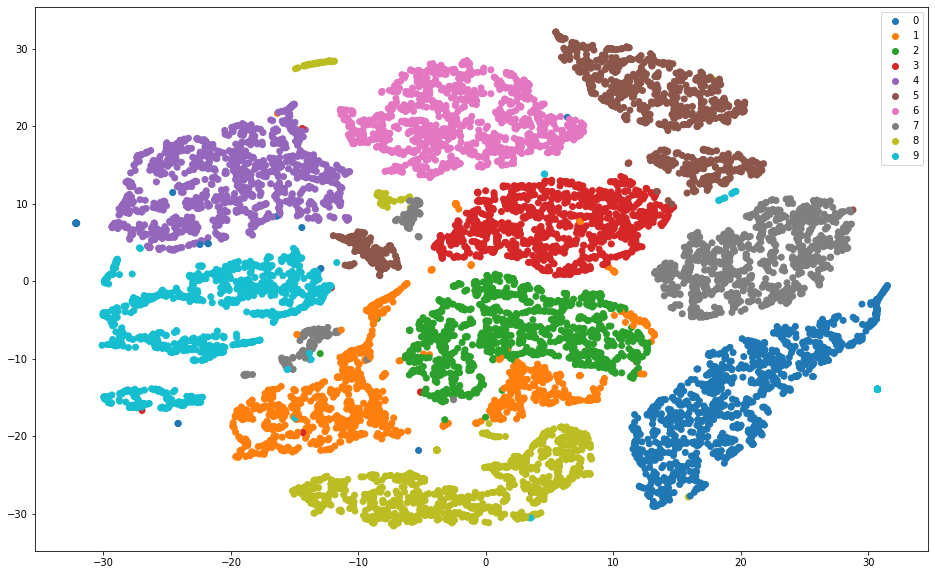

In [ ]:
dataset_labels = [0,1,2,3,4,5,6,7,8,9]

plt.figure(figsize=(16,10))
scatterplot = plt.scatter(
    x=TSNE_points[:,0], y=TSNE_points[:,1],
    c=Y_train,
    cmap="tab10"
)

handles, _ = scatterplot.legend_elements(prop='colors')
plt.legend(handles, dataset_labels)

In [15]:
# TODO: try additional noise features

def run_experiment(K, X, Y, epochs=10, hl1_neurons=30, hl2_neurons=20):

  print('Experiment results for k-means with k =', K, 'clusters:\n')
  print('Running k-means algorithm in order to get our pseudolabels: \n')

  kmeans_initial = KMeans(n_clusters=K, n_init=100).fit(X) 
  pseudo_labels = copy.deepcopy(kmeans_initial.labels_)
  real_labels = transform_clusters_to_labels(kmeans_initial.labels_, Y)

  # check TSNE representation of our features according to the k categories

  # print("TSNE representation of our features according to the k categories\n")

  # pseudolabels_indices = [i for i in range(K)]

  # plt.figure(figsize=(16,10)) 
  # kmeans_scatterplot = plt.scatter(
  #     x=TSNE_points[:,0], y=TSNE_points[:,1],
  #     c=pseudo_labels,
  #     cmap="gist_rainbow"
  # )

  # handles = kmeans_scatterplot.legend_elements(num=pseudolabels_indices)[0]
  # plt.legend(handles, pseudolabels_indices)

  # savestring = 'pseudolabels_TSNE_initial_space_k=' + str(K) + '.png'
  # plt.savefig(savestring)

  # find out accuracy of the algorithm in the initial space

  kmeans_initial_labels = kmeans_initial.labels_

  # the following metrics use the output of the clustering as input

  kmeans_initial_hungarian_acc = cluster_accuracy(Y, kmeans_initial_labels)[1]
  kmeans_initial_NMI = normalized_mutual_info_score(Y, kmeans_initial_labels)
  kmeans_initial_ARI = adjusted_rand_score(Y, kmeans_initial_labels)

  print("K_means greedy accuracy score (initial space, whole X set):",accuracy_score(Y, real_labels))
  print("K_means hungarian accuracy score (initial space, whole X set):",kmeans_initial_hungarian_acc)
  print("Normalised mutual info score (initial space, whole X set):",kmeans_initial_NMI)
  print("ARI (initial space, whole X set):",kmeans_initial_ARI, "\n")

  x_train, x_test, y_train, y_test = train_test_split(X, pseudo_labels, test_size=0.20) # we want a test set as well, so we split the initial set

  print('Preparing our data for the MLP model.\n')

  # first, the training dataset

  y_train = torch.from_numpy(y_train) # we need tensors in our MLP model
  y_train = y_train.type(torch.LongTensor) # need this dtype for MLP model
  x_train = torch.from_numpy(x_train)
  #x_train = x_train.unsqueeze(1) # in order to get a tensor of 4 dimensions (number of channels missing at first)
  x_train = x_train.double() # will need doubleTensor for our model
  my_train_dataset = CustomDataset(datapoints=x_train, labels=y_train)

  # then, the testing dataset

  y_test = torch.from_numpy(y_test) # we need tensors in our MLP model
  y_test = y_test.type(torch.LongTensor) # need this dtype for MLP model
  x_test = torch.from_numpy(x_test)
  #x_test = x_test.unsqueeze(1) # in order to get a tensor of 4 dimensions (number of channels missing at first)
  x_test = x_test.double() # will need doubleTensor for our model
  my_test_dataset = CustomDataset(datapoints=x_test, labels=y_test)

  # finally, the whole set, which will be run through the network in the end

  X = torch.from_numpy(X)
  #X = X.unsqueeze(1) # in order to get a tensor of 4 dimensions (number of channels missing at first)
  X = X.double() # will need doubleTensor for our model

  # using the MLP model on our data

  print('Using the MLP model on our data: \n')

  MLP_accuracy_scores = []
  kmeans_accuracy_scores = []
  kmeans_NMI_scores = []
  kmeans_ARI_scores = []
  agglo_accuracy_scores = []
  agglo_NMI_scores = []
  agglo_ARI_scores = []

  for i in range(10):

    print("ROUND NUMBER ",i + 1,":\n")
    MLP_model = MLP_module(input_dim=4,output_dim=K,train_dataset=my_train_dataset,test_dataset=my_test_dataset,valid_ratio=0.2,hl1_neurons=hl1_neurons, hl2_neurons=hl2_neurons, number_of_epochs=epochs)
    MLP_model.create_validation_set()
    MLP_model.define_dataLoaders()
    MLP_model.set_parameters()
    MLP_model.do_training()
    MLP_model.calculate_loss()

    # calculating stats
    MLP_trained_model = MLP_model.load_model() # load our model with its trained parameters

    # calculate outputs by running all the training images through the network
    MLP_outputs = MLP_model.forward(X)

    # the class with the highest energy is what we choose as pseudo-label-prediction
    predicted_pseudo_labels = torch.argmax(MLP_outputs, dim=1).cpu().detach().numpy()
    MLP_real_labels = transform_clusters_to_labels(predicted_pseudo_labels, Y)

    MLP_greedy_acc = accuracy_score(Y, MLP_real_labels)
    MLP_hungarian_acc = cluster_accuracy(Y, predicted_pseudo_labels)[1]
    MLP_accuracy_scores.append(MLP_hungarian_acc)

    print("\nMLP greedy accuracy score:", MLP_greedy_acc)
    print("MLP hungarian accuracy score:", MLP_hungarian_acc, "\n")
    
    print("Creating a k-means model on MLP-created space (with its vector outputs):\n")

    # Maybe we need Standar Scaler

    MLP_vectors = MLP_trained_model.get_hidden_representations(X.float()).detach().numpy()
    # MLP_vectors = std_scaler.fit_transform(MLP_vectors)

    # Plotting the MLP vectors' TSNE representation in order to see how the transformed space shapes up

    # if(i == 0):
    #   MLP_TSNE_points = TSNE(n_components=2, verbose=1, perplexity=20, n_iter=400, learning_rate='auto').fit_transform(MLP_vectors)

    #   plt.figure(figsize=(16,10))
    #   scatterplot = plt.scatter(
    #       x=MLP_TSNE_points[:,0], y=MLP_TSNE_points[:,1],
    #       c=Y,
    #       cmap="tab10"
    #   )

    #   handles, _ = scatterplot.legend_elements(prop='colors')
    #   plt.legend(handles, dataset_labels)

    #   savestring = 'transformed_space_TSNE_10_labels_k=' + str(K) + '.png'
    #   plt.savefig(savestring)

    new_kmeans = KMeans(n_clusters=3, n_init=100).fit(MLP_vectors) 
    kmeans_clusters = new_kmeans.labels_
    kmeans_greedy_labels = transform_clusters_to_labels(kmeans_clusters, Y)

    # print the stats on the transformed space
    kmeans_greedy_acc = accuracy_score(Y, kmeans_greedy_labels)
    kmeans_accuracy_scores.append(kmeans_greedy_acc)

    # These metrics as input they use the output of the clustering algorithm
    kmeans_hungarian_acc = cluster_accuracy(Y, kmeans_clusters)[1]
    kmeans_NMI = normalized_mutual_info_score(Y, kmeans_clusters)
    kmeans_ARI = adjusted_rand_score(Y, kmeans_clusters)

    kmeans_NMI_scores.append(kmeans_NMI)
    kmeans_ARI_scores.append(kmeans_ARI)

    print("K-means on MLP-transformed space greedy accuracy score:",kmeans_greedy_acc)
    print("K-means on MLP-transformed space hungarian accuracy score:",kmeans_hungarian_acc)
    print("Normalised mutual info score on k-means on MLP-transformed space:", kmeans_NMI, "\n")
    print("ARI score on k-means on MLP-transformed space:", kmeans_ARI, "\n")
    
    # do agglomerative clustering on the transformed space

    print("Doing agglomerative clustering on MLP output vectors:\n")
    aggloClustering = AgglomerativeClustering(n_clusters=3).fit(MLP_vectors)
    aggloClustering_clusters = aggloClustering.labels_
    agglo_greedy_labels = transform_clusters_to_labels(aggloClustering_clusters, Y)

    # print the stats on agglomerative clustering
    agglo_greedy_acc = accuracy_score(Y, agglo_greedy_labels)
    agglo_hungarian_acc = cluster_accuracy(Y, aggloClustering_clusters)[1]
    agglo_NMI = normalized_mutual_info_score(Y, aggloClustering_clusters)
    agglo_ARI = adjusted_rand_score(Y, aggloClustering_clusters)

    agglo_accuracy_scores.append(agglo_greedy_acc)
    agglo_NMI_scores.append(agglo_NMI)
    agglo_ARI_scores.append(agglo_ARI)

    print("Agglomerative clustering on MLP-transformed space greedy accuracy score:", agglo_greedy_acc)
    print("Agglomerative clustering on MLP-transformed space hungarian accuracy score:", agglo_hungarian_acc)
    print("Normalised mutual info score on agglomerative clustering on MLP-transformed space:",agglo_NMI)
    print("ARI score on agglomerative clustering on MLP-transformed space:", agglo_ARI, "\n")

  print("Average MLP accuracy score training at pseudolabels:", sum(MLP_accuracy_scores) / len(MLP_accuracy_scores), "\n")
  print("Average k-means accuracy score at latent space:", sum(kmeans_accuracy_scores) / len(kmeans_accuracy_scores), "\n")
  print("Average k-means NMI score at latent space:", sum(kmeans_NMI_scores) / len(kmeans_NMI_scores), "\n")
  print("Average k-means ARI score at latent space:", sum(kmeans_ARI_scores) / len(kmeans_ARI_scores), "\n")
  print("Average agglomerative clustering accuracy score at latent space:", sum(agglo_accuracy_scores) / len(agglo_accuracy_scores), "\n")
  print("Average agglomerative clustering NMI score at latent space:", sum(agglo_NMI_scores) / len(agglo_NMI_scores), "\n")
  print("Average agglomerative clustering ARI score at latent space:", sum(agglo_ARI_scores) / len(agglo_ARI_scores), "\n")

  return [MLP_accuracy_scores, kmeans_accuracy_scores, kmeans_NMI_scores, kmeans_ARI_scores, agglo_accuracy_scores, agglo_NMI_scores, agglo_ARI_scores]

In [22]:
results_for_k_5 = run_experiment(5, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 5 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.86
K_means hungarian accuracy score (initial space, whole X set): 0.86
Normalised mutual info score (initial space, whole X set): 0.7593367628576809
ARI (initial space, whole X set): 0.6736713703529151 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.550 | Train Acc: 54.17%
	 Val. Loss: 1.608 |  Val. Acc: 42.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.496 | Train Acc: 66.67%
	 Val. Loss: 1.607 |  Val. Acc: 42.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.449 | Train Acc: 66.67%
	 Val. Loss: 1.606 |  Val. Acc: 42.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.408 | Train Acc: 66.67%
	 Val. Loss: 1.605 |  Val. Acc: 56.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.370 | Train Acc: 66.67%
	 Val. Loss: 1.604 |  Val. Acc: 52.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.339 | Train Acc: 66.67%
	 Val. Loss: 1.602 |  Val. Acc: 49.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.314 | Train Acc: 70.83%
	 Val. Loss: 1.599 |  Val. Acc: 49.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.292 | Train Acc: 83.33%
	 Val. Loss: 1.597 |  Val. Acc: 49.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.273 | Train Acc: 83.33%
	 Val. Loss: 1.594 |  Val. Acc: 50.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.256 | Train Acc: 83.33%
	 Val. Loss: 1.590 |  Val. Acc: 51.56%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.590 | Test Acc: 60.00%

MLP greedy accuracy score: 0.8533333333333334
MLP hungarian accuracy score: 0.8533333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7933333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.6257831488068794 

ARI score on k-means on MLP-transformed space: 0.5671304879291026 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.76
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.76
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5822817254324323
ARI score on agglomerative clustering on MLP-transformed space: 0.5209313235811551 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.635 | Train Acc: 4.17%
	 Val. Loss: 1.610 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.590 | Train Acc: 41.67%
	 Val. Loss: 1.610 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.550 | Train Acc: 45.83%
	 Val. Loss: 1.609 |  Val. Acc: 26.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.516 | Train Acc: 50.00%
	 Val. Loss: 1.609 |  Val. Acc: 35.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.488 | Train Acc: 50.00%
	 Val. Loss: 1.607 |  Val. Acc: 39.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.464 | Train Acc: 50.00%
	 Val. Loss: 1.605 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.443 | Train Acc: 50.00%
	 Val. Loss: 1.601 |  Val. Acc: 56.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.423 | Train Acc: 54.17%
	 Val. Loss: 1.598 |  Val. Acc: 63.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.403 | Train Acc: 62.50%
	 Val. Loss: 1.595 |  Val. Acc: 64.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.384 | Train Acc: 66.67%
	 Val. Loss: 1.591 |  Val. Acc: 67.19%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.594 | Test Acc: 70.00%

MLP greedy accuracy score: 0.8866666666666667
MLP hungarian accuracy score: 0.8866666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8466666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6844324622022699 

ARI score on k-means on MLP-transformed space: 0.6439701499384083 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7391423580521324
ARI score on agglomerative clustering on MLP-transformed space: 0.6727427690537637 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.658 | Train Acc: 0.00%
	 Val. Loss: 1.609 |  Val. Acc: 25.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.630 | Train Acc: 4.17%
	 Val. Loss: 1.609 |  Val. Acc: 24.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.602 | Train Acc: 20.83%
	 Val. Loss: 1.609 |  Val. Acc: 26.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.571 | Train Acc: 37.50%
	 Val. Loss: 1.608 |  Val. Acc: 42.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.538 | Train Acc: 50.00%
	 Val. Loss: 1.608 |  Val. Acc: 43.75%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.500 | Train Acc: 58.33%
	 Val. Loss: 1.607 |  Val. Acc: 41.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.463 | Train Acc: 75.00%
	 Val. Loss: 1.605 |  Val. Acc: 41.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.428 | Train Acc: 83.33%
	 Val. Loss: 1.604 |  Val. Acc: 41.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.397 | Train Acc: 87.50%
	 Val. Loss: 1.602 |  Val. Acc: 42.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.372 | Train Acc: 83.33%
	 Val. Loss: 1.600 |  Val. Acc: 47.66%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.601 | Test Acc: 53.33%

MLP greedy accuracy score: 0.78
MLP hungarian accuracy score: 0.78 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.6665154497220922 

ARI score on k-means on MLP-transformed space: 0.6556007678378779 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.86
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7330637153269233
ARI score on agglomerative clustering on MLP-transformed space: 0.6614133258247837 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.620 | Train Acc: 20.83%
	 Val. Loss: 1.609 |  Val. Acc: 32.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.587 | Train Acc: 50.00%
	 Val. Loss: 1.608 |  Val. Acc: 24.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.552 | Train Acc: 58.33%
	 Val. Loss: 1.607 |  Val. Acc: 21.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.519 | Train Acc: 58.33%
	 Val. Loss: 1.607 |  Val. Acc: 23.44%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.490 | Train Acc: 58.33%
	 Val. Loss: 1.606 |  Val. Acc: 25.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.465 | Train Acc: 66.67%
	 Val. Loss: 1.605 |  Val. Acc: 29.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.439 | Train Acc: 66.67%
	 Val. Loss: 1.604 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.415 | Train Acc: 70.83%
	 Val. Loss: 1.602 |  Val. Acc: 46.09%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.393 | Train Acc: 70.83%
	 Val. Loss: 1.600 |  Val. Acc: 48.44%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.371 | Train Acc: 79.17%
	 Val. Loss: 1.598 |  Val. Acc: 47.66%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.598 | Test Acc: 46.67%

MLP greedy accuracy score: 0.82
MLP hungarian accuracy score: 0.82 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6404527300947984 

ARI score on k-means on MLP-transformed space: 0.5914276853771199 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7165852410385648
ARI score on agglomerative clustering on MLP-transformed space: 0.6304299118321076 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.649 | Train Acc: 8.33%
	 Val. Loss: 1.611 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.622 | Train Acc: 16.67%
	 Val. Loss: 1.611 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.590 | Train Acc: 41.67%
	 Val. Loss: 1.610 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.553 | Train Acc: 50.00%
	 Val. Loss: 1.608 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.514 | Train Acc: 58.33%
	 Val. Loss: 1.607 |  Val. Acc: 26.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.477 | Train Acc: 58.33%
	 Val. Loss: 1.605 |  Val. Acc: 32.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.443 | Train Acc: 58.33%
	 Val. Loss: 1.603 |  Val. Acc: 35.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.413 | Train Acc: 66.67%
	 Val. Loss: 1.600 |  Val. Acc: 36.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.386 | Train Acc: 70.83%
	 Val. Loss: 1.597 |  Val. Acc: 37.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.363 | Train Acc: 70.83%
	 Val. Loss: 1.594 |  Val. Acc: 42.19%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.587 | Test Acc: 60.00%

MLP greedy accuracy score: 0.58
MLP hungarian accuracy score: 0.58 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8533333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8533333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6818188711582578 

ARI score on k-means on MLP-transformed space: 0.652516389967057 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.88
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.88
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7522564736769
ARI score on agglomerative clustering on MLP-transformed space: 0.6969015142734964 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.611 | Train Acc: 20.83%
	 Val. Loss: 1.609 |  Val. Acc: 22.66%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.572 | Train Acc: 33.33%
	 Val. Loss: 1.608 |  Val. Acc: 22.66%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.532 | Train Acc: 50.00%
	 Val. Loss: 1.606 |  Val. Acc: 35.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.494 | Train Acc: 66.67%
	 Val. Loss: 1.604 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.462 | Train Acc: 75.00%
	 Val. Loss: 1.602 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.434 | Train Acc: 79.17%
	 Val. Loss: 1.600 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.410 | Train Acc: 79.17%
	 Val. Loss: 1.598 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.387 | Train Acc: 79.17%
	 Val. Loss: 1.595 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.366 | Train Acc: 83.33%
	 Val. Loss: 1.593 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.345 | Train Acc: 83.33%
	 Val. Loss: 1.590 |  Val. Acc: 40.62%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.600 | Test Acc: 20.00%

MLP greedy accuracy score: 0.7133333333333334
MLP hungarian accuracy score: 0.7133333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7866666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.627944024028206 

ARI score on k-means on MLP-transformed space: 0.5632429170303794 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8466666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7489500874010819
ARI score on agglomerative clustering on MLP-transformed space: 0.6536925558315911 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.623 | Train Acc: 33.33%
	 Val. Loss: 1.609 |  Val. Acc: 25.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.574 | Train Acc: 54.17%
	 Val. Loss: 1.607 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.531 | Train Acc: 50.00%
	 Val. Loss: 1.606 |  Val. Acc: 46.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.494 | Train Acc: 50.00%
	 Val. Loss: 1.604 |  Val. Acc: 50.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.458 | Train Acc: 58.33%
	 Val. Loss: 1.602 |  Val. Acc: 50.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.427 | Train Acc: 62.50%
	 Val. Loss: 1.600 |  Val. Acc: 50.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.400 | Train Acc: 66.67%
	 Val. Loss: 1.598 |  Val. Acc: 50.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.375 | Train Acc: 70.83%
	 Val. Loss: 1.596 |  Val. Acc: 52.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.353 | Train Acc: 70.83%
	 Val. Loss: 1.593 |  Val. Acc: 55.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.334 | Train Acc: 75.00%
	 Val. Loss: 1.590 |  Val. Acc: 53.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.594 | Test Acc: 60.00%

MLP greedy accuracy score: 0.8666666666666667
MLP hungarian accuracy score: 0.8666666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.88
K-means on MLP-transformed space hungarian accuracy score: 0.88
Normalised mutual info score on k-means on MLP-transformed space: 0.7560871362392072 

ARI score on k-means on MLP-transformed space: 0.7060059674676762 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7709004737914571
ARI score on agglomerative clustering on MLP-transformed space: 0.6956362463515929 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.633 | Train Acc: 8.33%
	 Val. Loss: 1.604 |  Val. Acc: 30.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.594 | Train Acc: 29.17%
	 Val. Loss: 1.603 |  Val. Acc: 30.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.553 | Train Acc: 45.83%
	 Val. Loss: 1.602 |  Val. Acc: 30.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.511 | Train Acc: 62.50%
	 Val. Loss: 1.601 |  Val. Acc: 30.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.472 | Train Acc: 62.50%
	 Val. Loss: 1.600 |  Val. Acc: 30.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.437 | Train Acc: 62.50%
	 Val. Loss: 1.598 |  Val. Acc: 32.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.409 | Train Acc: 62.50%
	 Val. Loss: 1.596 |  Val. Acc: 39.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.387 | Train Acc: 62.50%
	 Val. Loss: 1.595 |  Val. Acc: 24.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.370 | Train Acc: 66.67%
	 Val. Loss: 1.592 |  Val. Acc: 21.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.356 | Train Acc: 66.67%
	 Val. Loss: 1.590 |  Val. Acc: 20.31%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.597 | Test Acc: 10.00%

MLP greedy accuracy score: 0.5866666666666667
MLP hungarian accuracy score: 0.5866666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6404527300947984 

ARI score on k-means on MLP-transformed space: 0.5914276853771199 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.68
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.68
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.585058136056666
ARI score on agglomerative clustering on MLP-transformed space: 0.4990139342407294 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.658 | Train Acc: 4.17%
	 Val. Loss: 1.611 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.621 | Train Acc: 16.67%
	 Val. Loss: 1.609 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.577 | Train Acc: 29.17%
	 Val. Loss: 1.608 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.534 | Train Acc: 45.83%
	 Val. Loss: 1.606 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.495 | Train Acc: 50.00%
	 Val. Loss: 1.604 |  Val. Acc: 35.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.463 | Train Acc: 62.50%
	 Val. Loss: 1.602 |  Val. Acc: 46.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.435 | Train Acc: 66.67%
	 Val. Loss: 1.600 |  Val. Acc: 49.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.410 | Train Acc: 75.00%
	 Val. Loss: 1.598 |  Val. Acc: 50.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.388 | Train Acc: 75.00%
	 Val. Loss: 1.596 |  Val. Acc: 50.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.367 | Train Acc: 75.00%
	 Val. Loss: 1.594 |  Val. Acc: 50.00%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.593 | Test Acc: 43.33%

MLP greedy accuracy score: 0.68
MLP hungarian accuracy score: 0.68 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8466666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6516495109008545 

ARI score on k-means on MLP-transformed space: 0.6317868792548544 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7391423580521324
ARI score on agglomerative clustering on MLP-transformed space: 0.6727427690537637 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 1.614 | Train Acc: 20.83%
	 Val. Loss: 1.607 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 1.549 | Train Acc: 50.00%
	 Val. Loss: 1.605 |  Val. Acc: 22.66%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 1.502 | Train Acc: 54.17%
	 Val. Loss: 1.603 |  Val. Acc: 21.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 1.464 | Train Acc: 66.67%
	 Val. Loss: 1.601 |  Val. Acc: 25.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 1.430 | Train Acc: 70.83%
	 Val. Loss: 1.598 |  Val. Acc: 31.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 1.398 | Train Acc: 79.17%
	 Val. Loss: 1.596 |  Val. Acc: 35.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 1.367 | Train Acc: 87.50%
	 Val. Loss: 1.593 |  Val. Acc: 39.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 1.339 | Train Acc: 87.50%
	 Val. Loss: 1.590 |  Val. Acc: 40.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 1.312 | Train Acc: 87.50%
	 Val. Loss: 1.586 |  Val. Acc: 42.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 1.287 | Train Acc: 91.67%
	 Val. Loss: 1.583 |  Val. Acc: 44.53%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 1.588 | Test Acc: 36.67%

MLP greedy accuracy score: 0.7466666666666667
MLP hungarian accuracy score: 0.7466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8733333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.8733333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.7709004737914571 

ARI score on k-means on MLP-transformed space: 0.6956362463515929 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7709004737914571
ARI score on agglomerative clustering on MLP-transformed space: 0.6956362463515929 

Average MLP accuracy score training at pseudolabels: 0.

In [23]:
results_for_k_10 = run_experiment(10, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 10 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.9666666666666667
K_means hungarian accuracy score (initial space, whole X set): 0.9666666666666667
Normalised mutual info score (initial space, whole X set): 0.8850620966553381
ARI (initial space, whole X set): 0.9037675791580496 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.282 | Train Acc: 20.83%
	 Val. Loss: 2.304 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.252 | Train Acc: 37.50%
	 Val. Loss: 2.304 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.223 | Train Acc: 50.00%
	 Val. Loss: 2.303 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.194 | Train Acc: 50.00%
	 Val. Loss: 2.303 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.165 | Train Acc: 54.17%
	 Val. Loss: 2.302 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.139 | Train Acc: 62.50%
	 Val. Loss: 2.302 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.117 | Train Acc: 62.50%
	 Val. Loss: 2.301 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.095 | Train Acc: 62.50%
	 Val. Loss: 2.301 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.075 | Train Acc: 62.50%
	 Val. Loss: 2.300 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.055 | Train Acc: 66.67%
	 Val. Loss: 2.299 |  Val. Acc: 14.06%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.297 | Test Acc: 16.67%

MLP greedy accuracy score: 0.8133333333333334
MLP hungarian accuracy score: 0.8133333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7466666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.7466666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.5938276480897519 

ARI score on k-means on MLP-transformed space: 0.5255059347945923 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5951076292404927
ARI score on agglomerative clustering on MLP-transformed space: 0.5157726055623341 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.322 | Train Acc: 0.00%
	 Val. Loss: 2.304 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.309 | Train Acc: 8.33%
	 Val. Loss: 2.303 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.291 | Train Acc: 29.17%
	 Val. Loss: 2.303 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.273 | Train Acc: 45.83%
	 Val. Loss: 2.302 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.253 | Train Acc: 50.00%
	 Val. Loss: 2.302 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.234 | Train Acc: 54.17%
	 Val. Loss: 2.301 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.215 | Train Acc: 54.17%
	 Val. Loss: 2.301 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.196 | Train Acc: 62.50%
	 Val. Loss: 2.300 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.179 | Train Acc: 62.50%
	 Val. Loss: 2.299 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.162 | Train Acc: 62.50%
	 Val. Loss: 2.297 |  Val. Acc: 18.75%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.299 | Test Acc: 13.33%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.6890518004413541 

ARI score on k-means on MLP-transformed space: 0.6638956080488512 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8133333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7277065247567378
ARI score on agglomerative clustering on MLP-transformed space: 0.6123997398655973 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.311 | Train Acc: 8.33%
	 Val. Loss: 2.303 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.292 | Train Acc: 8.33%
	 Val. Loss: 2.303 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.272 | Train Acc: 25.00%
	 Val. Loss: 2.302 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.248 | Train Acc: 25.00%
	 Val. Loss: 2.302 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.224 | Train Acc: 33.33%
	 Val. Loss: 2.301 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.201 | Train Acc: 37.50%
	 Val. Loss: 2.301 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.178 | Train Acc: 41.67%
	 Val. Loss: 2.300 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.157 | Train Acc: 62.50%
	 Val. Loss: 2.299 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.137 | Train Acc: 62.50%
	 Val. Loss: 2.298 |  Val. Acc: 24.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.118 | Train Acc: 62.50%
	 Val. Loss: 2.297 |  Val. Acc: 24.22%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.298 | Test Acc: 30.00%

MLP greedy accuracy score: 0.6466666666666666
MLP hungarian accuracy score: 0.6466666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8333333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6607920793426151 

ARI score on k-means on MLP-transformed space: 0.62055617805847 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.86
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6848688956741777
ARI score on agglomerative clustering on MLP-transformed space: 0.6611367475393747 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.318 | Train Acc: 0.00%
	 Val. Loss: 2.302 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.303 | Train Acc: 12.50%
	 Val. Loss: 2.302 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.285 | Train Acc: 20.83%
	 Val. Loss: 2.302 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.265 | Train Acc: 33.33%
	 Val. Loss: 2.301 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.243 | Train Acc: 45.83%
	 Val. Loss: 2.301 |  Val. Acc: 20.31%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.222 | Train Acc: 54.17%
	 Val. Loss: 2.300 |  Val. Acc: 31.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.201 | Train Acc: 54.17%
	 Val. Loss: 2.299 |  Val. Acc: 32.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.180 | Train Acc: 54.17%
	 Val. Loss: 2.298 |  Val. Acc: 31.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.161 | Train Acc: 62.50%
	 Val. Loss: 2.298 |  Val. Acc: 30.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.141 | Train Acc: 62.50%
	 Val. Loss: 2.296 |  Val. Acc: 30.47%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.297 | Test Acc: 26.67%

MLP greedy accuracy score: 0.8733333333333333
MLP hungarian accuracy score: 0.8733333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8333333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6588407919873353 

ARI score on k-means on MLP-transformed space: 0.6199243317810601 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.610349738482192
ARI score on agglomerative clustering on MLP-transformed space: 0.5712746462490358 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.322 | Train Acc: 0.00%
	 Val. Loss: 2.303 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.303 | Train Acc: 4.17%
	 Val. Loss: 2.302 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.281 | Train Acc: 12.50%
	 Val. Loss: 2.302 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.257 | Train Acc: 25.00%
	 Val. Loss: 2.301 |  Val. Acc: 21.09%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.232 | Train Acc: 41.67%
	 Val. Loss: 2.301 |  Val. Acc: 31.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.207 | Train Acc: 41.67%
	 Val. Loss: 2.300 |  Val. Acc: 29.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.182 | Train Acc: 50.00%
	 Val. Loss: 2.300 |  Val. Acc: 29.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.160 | Train Acc: 54.17%
	 Val. Loss: 2.299 |  Val. Acc: 30.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.139 | Train Acc: 58.33%
	 Val. Loss: 2.298 |  Val. Acc: 32.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.121 | Train Acc: 62.50%
	 Val. Loss: 2.297 |  Val. Acc: 32.81%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.293 | Test Acc: 46.67%

MLP greedy accuracy score: 0.9533333333333334
MLP hungarian accuracy score: 0.9533333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.9066666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.9066666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.8056936912153358 

ARI score on k-means on MLP-transformed space: 0.7591987071071522 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7391423580521324
ARI score on agglomerative clustering on MLP-transformed space: 0.6727427690537637 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.307 | Train Acc: 4.17%
	 Val. Loss: 2.302 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.282 | Train Acc: 25.00%
	 Val. Loss: 2.302 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.257 | Train Acc: 29.17%
	 Val. Loss: 2.301 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.231 | Train Acc: 33.33%
	 Val. Loss: 2.301 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.205 | Train Acc: 37.50%
	 Val. Loss: 2.300 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.180 | Train Acc: 54.17%
	 Val. Loss: 2.300 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.156 | Train Acc: 62.50%
	 Val. Loss: 2.299 |  Val. Acc: 24.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.132 | Train Acc: 70.83%
	 Val. Loss: 2.298 |  Val. Acc: 22.66%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.107 | Train Acc: 70.83%
	 Val. Loss: 2.297 |  Val. Acc: 25.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.084 | Train Acc: 70.83%
	 Val. Loss: 2.296 |  Val. Acc: 30.47%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.295 | Test Acc: 20.00%

MLP greedy accuracy score: 0.8933333333333333
MLP hungarian accuracy score: 0.8933333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6426583176523605 

ARI score on k-means on MLP-transformed space: 0.5923326221845838 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7165852410385648
ARI score on agglomerative clustering on MLP-transformed space: 0.6304299118321076 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.310 | Train Acc: 4.17%
	 Val. Loss: 2.303 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.293 | Train Acc: 16.67%
	 Val. Loss: 2.302 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.274 | Train Acc: 25.00%
	 Val. Loss: 2.302 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.251 | Train Acc: 41.67%
	 Val. Loss: 2.302 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.230 | Train Acc: 45.83%
	 Val. Loss: 2.301 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.210 | Train Acc: 41.67%
	 Val. Loss: 2.301 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.191 | Train Acc: 45.83%
	 Val. Loss: 2.300 |  Val. Acc: 18.75%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.174 | Train Acc: 45.83%
	 Val. Loss: 2.299 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.156 | Train Acc: 50.00%
	 Val. Loss: 2.298 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.140 | Train Acc: 50.00%
	 Val. Loss: 2.297 |  Val. Acc: 20.31%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.300 | Test Acc: 6.67%

MLP greedy accuracy score: 0.8
MLP hungarian accuracy score: 0.8 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7333333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7333333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.5908978447594194 

ARI score on k-means on MLP-transformed space: 0.5192329176178967 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.76
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.76
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6162248554897048
ARI score on agglomerative clustering on MLP-transformed space: 0.541082485803202 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.312 | Train Acc: 4.17%
	 Val. Loss: 2.303 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.294 | Train Acc: 12.50%
	 Val. Loss: 2.304 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.273 | Train Acc: 29.17%
	 Val. Loss: 2.304 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.249 | Train Acc: 37.50%
	 Val. Loss: 2.304 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.227 | Train Acc: 37.50%
	 Val. Loss: 2.304 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.207 | Train Acc: 33.33%
	 Val. Loss: 2.304 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.188 | Train Acc: 37.50%
	 Val. Loss: 2.304 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.171 | Train Acc: 37.50%
	 Val. Loss: 2.304 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.154 | Train Acc: 41.67%
	 Val. Loss: 2.304 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.139 | Train Acc: 50.00%
	 Val. Loss: 2.303 |  Val. Acc: 10.94%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.303 | Test Acc: 3.33%

MLP greedy accuracy score: 0.56
MLP hungarian accuracy score: 0.56 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.76
K-means on MLP-transformed space hungarian accuracy score: 0.76
Normalised mutual info score on k-means on MLP-transformed space: 0.5774547241245599 

ARI score on k-means on MLP-transformed space: 0.5185662456858643 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7533333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5913599660623003
ARI score on agglomerative clustering on MLP-transformed space: 0.5265947030401369 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.306 | Train Acc: 4.17%
	 Val. Loss: 2.303 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.284 | Train Acc: 12.50%
	 Val. Loss: 2.303 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.257 | Train Acc: 20.83%
	 Val. Loss: 2.302 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.226 | Train Acc: 50.00%
	 Val. Loss: 2.302 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.194 | Train Acc: 62.50%
	 Val. Loss: 2.302 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.162 | Train Acc: 62.50%
	 Val. Loss: 2.301 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.134 | Train Acc: 66.67%
	 Val. Loss: 2.301 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.108 | Train Acc: 66.67%
	 Val. Loss: 2.300 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.087 | Train Acc: 66.67%
	 Val. Loss: 2.299 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.068 | Train Acc: 66.67%
	 Val. Loss: 2.298 |  Val. Acc: 13.28%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.295 | Test Acc: 26.67%

MLP greedy accuracy score: 0.48
MLP hungarian accuracy score: 0.48 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7866666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.6331999135536271 

ARI score on k-means on MLP-transformed space: 0.5662325509261267 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.74
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.74
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6539530150658621
ARI score on agglomerative clustering on MLP-transformed space: 0.5490728890256734 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.297 | Train Acc: 20.83%
	 Val. Loss: 2.299 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.270 | Train Acc: 25.00%
	 Val. Loss: 2.299 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.244 | Train Acc: 25.00%
	 Val. Loss: 2.299 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.219 | Train Acc: 25.00%
	 Val. Loss: 2.298 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.195 | Train Acc: 33.33%
	 Val. Loss: 2.298 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.174 | Train Acc: 37.50%
	 Val. Loss: 2.297 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.155 | Train Acc: 45.83%
	 Val. Loss: 2.296 |  Val. Acc: 27.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.136 | Train Acc: 50.00%
	 Val. Loss: 2.296 |  Val. Acc: 28.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.117 | Train Acc: 54.17%
	 Val. Loss: 2.295 |  Val. Acc: 24.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.097 | Train Acc: 62.50%
	 Val. Loss: 2.294 |  Val. Acc: 25.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.297 | Test Acc: 16.67%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.94
K-means on MLP-transformed space hungarian accuracy score: 0.94
Normalised mutual info score on k-means on MLP-transformed space: 0.8167114929527717 

ARI score on k-means on MLP-transformed space: 0.833982948121967 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7709004737914571
ARI score on agglomerative clustering on MLP-transformed space: 0.6956362463515929 

Average MLP accuracy score training at pseudolabels: 0.7353333333333334 

Average k-

In [24]:
results_for_k_15 = run_experiment(15, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 15 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.9533333333333334
K_means hungarian accuracy score (initial space, whole X set): 0.9533333333333334
Normalised mutual info score (initial space, whole X set): 0.8737689678907916
ARI (initial space, whole X set): 0.868475753865429 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.704 | Train Acc: 4.17%
	 Val. Loss: 2.707 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.684 | Train Acc: 20.83%
	 Val. Loss: 2.707 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.659 | Train Acc: 29.17%
	 Val. Loss: 2.706 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.632 | Train Acc: 33.33%
	 Val. Loss: 2.706 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.604 | Train Acc: 37.50%
	 Val. Loss: 2.705 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.582 | Train Acc: 41.67%
	 Val. Loss: 2.705 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.563 | Train Acc: 45.83%
	 Val. Loss: 2.704 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.545 | Train Acc: 45.83%
	 Val. Loss: 2.703 |  Val. Acc: 25.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.527 | Train Acc: 45.83%
	 Val. Loss: 2.703 |  Val. Acc: 22.66%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.511 | Train Acc: 50.00%
	 Val. Loss: 2.702 |  Val. Acc: 21.09%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.704 | Test Acc: 10.00%

MLP greedy accuracy score: 0.92
MLP hungarian accuracy score: 0.92 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.6907358850090398 

ARI score on k-means on MLP-transformed space: 0.6642681063461342 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6944564207304548
ARI score on agglomerative clustering on MLP-transformed space: 0.5887672690134623 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.716 | Train Acc: 0.00%
	 Val. Loss: 2.709 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.708 | Train Acc: 0.00%
	 Val. Loss: 2.709 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.698 | Train Acc: 16.67%
	 Val. Loss: 2.708 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.688 | Train Acc: 37.50%
	 Val. Loss: 2.708 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.676 | Train Acc: 50.00%
	 Val. Loss: 2.707 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.663 | Train Acc: 62.50%
	 Val. Loss: 2.707 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.649 | Train Acc: 62.50%
	 Val. Loss: 2.706 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.634 | Train Acc: 62.50%
	 Val. Loss: 2.706 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.619 | Train Acc: 62.50%
	 Val. Loss: 2.705 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.602 | Train Acc: 62.50%
	 Val. Loss: 2.704 |  Val. Acc: 19.53%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.706 | Test Acc: 16.67%

MLP greedy accuracy score: 0.7866666666666666
MLP hungarian accuracy score: 0.7866666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6083404722426905 

ARI score on k-means on MLP-transformed space: 0.5396081627109436 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.635180813172581
ARI score on agglomerative clustering on MLP-transformed space: 0.5828577799714192 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.698 | Train Acc: 12.50%
	 Val. Loss: 2.709 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.680 | Train Acc: 20.83%
	 Val. Loss: 2.708 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.661 | Train Acc: 33.33%
	 Val. Loss: 2.708 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.642 | Train Acc: 54.17%
	 Val. Loss: 2.708 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.625 | Train Acc: 54.17%
	 Val. Loss: 2.708 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.609 | Train Acc: 58.33%
	 Val. Loss: 2.708 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.593 | Train Acc: 58.33%
	 Val. Loss: 2.708 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.576 | Train Acc: 58.33%
	 Val. Loss: 2.707 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.559 | Train Acc: 58.33%
	 Val. Loss: 2.707 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.543 | Train Acc: 58.33%
	 Val. Loss: 2.707 |  Val. Acc: 7.81%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.707 | Test Acc: 3.33%

MLP greedy accuracy score: 0.58
MLP hungarian accuracy score: 0.58 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6280115332436487 

ARI score on k-means on MLP-transformed space: 0.5931262340647263 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6194928877649326
ARI score on agglomerative clustering on MLP-transformed space: 0.5734589310733277 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.718 | Train Acc: 8.33%
	 Val. Loss: 2.708 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.708 | Train Acc: 8.33%
	 Val. Loss: 2.708 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.694 | Train Acc: 8.33%
	 Val. Loss: 2.708 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.679 | Train Acc: 29.17%
	 Val. Loss: 2.708 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.663 | Train Acc: 37.50%
	 Val. Loss: 2.708 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.647 | Train Acc: 41.67%
	 Val. Loss: 2.708 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.631 | Train Acc: 41.67%
	 Val. Loss: 2.707 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.615 | Train Acc: 45.83%
	 Val. Loss: 2.707 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.599 | Train Acc: 45.83%
	 Val. Loss: 2.707 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.584 | Train Acc: 45.83%
	 Val. Loss: 2.706 |  Val. Acc: 15.62%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.704 | Test Acc: 20.00%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6751584412042868 

ARI score on k-means on MLP-transformed space: 0.6678092859581611 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7533333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6417672604333441
ARI score on agglomerative clustering on MLP-transformed space: 0.5503313846110766 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.711 | Train Acc: 4.17%
	 Val. Loss: 2.708 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.696 | Train Acc: 12.50%
	 Val. Loss: 2.707 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.677 | Train Acc: 25.00%
	 Val. Loss: 2.707 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.658 | Train Acc: 33.33%
	 Val. Loss: 2.707 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.637 | Train Acc: 37.50%
	 Val. Loss: 2.706 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.618 | Train Acc: 45.83%
	 Val. Loss: 2.706 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.598 | Train Acc: 45.83%
	 Val. Loss: 2.706 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.578 | Train Acc: 45.83%
	 Val. Loss: 2.705 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.559 | Train Acc: 45.83%
	 Val. Loss: 2.704 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.542 | Train Acc: 50.00%
	 Val. Loss: 2.704 |  Val. Acc: 16.41%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.705 | Test Acc: 16.67%

MLP greedy accuracy score: 0.68
MLP hungarian accuracy score: 0.68 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6426583176523605 

ARI score on k-means on MLP-transformed space: 0.5923326221845838 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7441744155974127
ARI score on agglomerative clustering on MLP-transformed space: 0.644447235392006 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.708 | Train Acc: 8.33%
	 Val. Loss: 2.707 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.695 | Train Acc: 12.50%
	 Val. Loss: 2.707 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.679 | Train Acc: 20.83%
	 Val. Loss: 2.707 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.661 | Train Acc: 41.67%
	 Val. Loss: 2.707 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.642 | Train Acc: 41.67%
	 Val. Loss: 2.707 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.623 | Train Acc: 54.17%
	 Val. Loss: 2.706 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.603 | Train Acc: 58.33%
	 Val. Loss: 2.706 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.585 | Train Acc: 62.50%
	 Val. Loss: 2.706 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.567 | Train Acc: 62.50%
	 Val. Loss: 2.706 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.551 | Train Acc: 58.33%
	 Val. Loss: 2.705 |  Val. Acc: 7.81%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.709 | Test Acc: 0.00%

MLP greedy accuracy score: 0.41333333333333333
MLP hungarian accuracy score: 0.41333333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.78
K-means on MLP-transformed space hungarian accuracy score: 0.78
Normalised mutual info score on k-means on MLP-transformed space: 0.617803075655596 

ARI score on k-means on MLP-transformed space: 0.5533024451558578 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6131906310523159
ARI score on agglomerative clustering on MLP-transformed space: 0.5426494020947933 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.704 | Train Acc: 4.17%
	 Val. Loss: 2.708 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.685 | Train Acc: 16.67%
	 Val. Loss: 2.708 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.663 | Train Acc: 29.17%
	 Val. Loss: 2.708 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.642 | Train Acc: 37.50%
	 Val. Loss: 2.708 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.624 | Train Acc: 37.50%
	 Val. Loss: 2.708 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.606 | Train Acc: 41.67%
	 Val. Loss: 2.707 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.590 | Train Acc: 41.67%
	 Val. Loss: 2.707 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.576 | Train Acc: 41.67%
	 Val. Loss: 2.707 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.563 | Train Acc: 41.67%
	 Val. Loss: 2.706 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.550 | Train Acc: 37.50%
	 Val. Loss: 2.706 |  Val. Acc: 14.84%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.706 | Test Acc: 13.33%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7733333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7733333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.647711103878191 

ARI score on k-means on MLP-transformed space: 0.5622856465794249 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6769632037353037
ARI score on agglomerative clustering on MLP-transformed space: 0.5948182832357677 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.708 | Train Acc: 8.33%
	 Val. Loss: 2.708 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.690 | Train Acc: 12.50%
	 Val. Loss: 2.708 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.668 | Train Acc: 25.00%
	 Val. Loss: 2.708 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.644 | Train Acc: 33.33%
	 Val. Loss: 2.707 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.619 | Train Acc: 50.00%
	 Val. Loss: 2.707 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.598 | Train Acc: 58.33%
	 Val. Loss: 2.706 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.580 | Train Acc: 62.50%
	 Val. Loss: 2.706 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.563 | Train Acc: 62.50%
	 Val. Loss: 2.705 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.547 | Train Acc: 62.50%
	 Val. Loss: 2.704 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.534 | Train Acc: 62.50%
	 Val. Loss: 2.703 |  Val. Acc: 19.53%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.705 | Test Acc: 10.00%

MLP greedy accuracy score: 0.7
MLP hungarian accuracy score: 0.7 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6496443831061652 

ARI score on k-means on MLP-transformed space: 0.6017906464957918 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7165852410385648
ARI score on agglomerative clustering on MLP-transformed space: 0.6304299118321076 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.704 | Train Acc: 4.17%
	 Val. Loss: 2.708 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.688 | Train Acc: 20.83%
	 Val. Loss: 2.708 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.672 | Train Acc: 25.00%
	 Val. Loss: 2.708 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.656 | Train Acc: 25.00%
	 Val. Loss: 2.708 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.641 | Train Acc: 25.00%
	 Val. Loss: 2.708 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.628 | Train Acc: 25.00%
	 Val. Loss: 2.708 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.617 | Train Acc: 25.00%
	 Val. Loss: 2.708 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.608 | Train Acc: 25.00%
	 Val. Loss: 2.707 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.599 | Train Acc: 25.00%
	 Val. Loss: 2.707 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.590 | Train Acc: 29.17%
	 Val. Loss: 2.707 |  Val. Acc: 6.25%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.707 | Test Acc: 6.67%

MLP greedy accuracy score: 0.34
MLP hungarian accuracy score: 0.34 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7466666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.7466666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.5758561717001546 

ARI score on k-means on MLP-transformed space: 0.5083896740863909 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7333333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7333333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6385047207797914
ARI score on agglomerative clustering on MLP-transformed space: 0.5425559321437503 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.708 | Train Acc: 12.50%
	 Val. Loss: 2.709 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.694 | Train Acc: 16.67%
	 Val. Loss: 2.709 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.675 | Train Acc: 33.33%
	 Val. Loss: 2.709 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.654 | Train Acc: 37.50%
	 Val. Loss: 2.709 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.632 | Train Acc: 37.50%
	 Val. Loss: 2.709 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.611 | Train Acc: 37.50%
	 Val. Loss: 2.708 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.591 | Train Acc: 41.67%
	 Val. Loss: 2.708 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.573 | Train Acc: 50.00%
	 Val. Loss: 2.708 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.558 | Train Acc: 50.00%
	 Val. Loss: 2.707 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.545 | Train Acc: 50.00%
	 Val. Loss: 2.707 |  Val. Acc: 10.94%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.706 | Test Acc: 13.33%

MLP greedy accuracy score: 0.5
MLP hungarian accuracy score: 0.5 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6348917053985356 

ARI score on k-means on MLP-transformed space: 0.5960557197994562 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.94
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.94
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.8167114929527717
ARI score on agglomerative clustering on MLP-transformed space: 0.833982948121967 

Average MLP accuracy score training at pseudolabels: 0.6253333333333334 

Average k-means accuracy score at latent space: 0.8066666666666669 


In [25]:
results_for_k_20 = run_experiment(20, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 20 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.96
K_means hungarian accuracy score (initial space, whole X set): 0.96
Normalised mutual info score (initial space, whole X set): 0.8641855068202222
ARI (initial space, whole X set): 0.8856970310281228 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.987 | Train Acc: 16.67%
	 Val. Loss: 2.994 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.967 | Train Acc: 37.50%
	 Val. Loss: 2.994 |  Val. Acc: 21.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.944 | Train Acc: 54.17%
	 Val. Loss: 2.994 |  Val. Acc: 21.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.920 | Train Acc: 54.17%
	 Val. Loss: 2.994 |  Val. Acc: 21.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.896 | Train Acc: 58.33%
	 Val. Loss: 2.994 |  Val. Acc: 21.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.874 | Train Acc: 58.33%
	 Val. Loss: 2.994 |  Val. Acc: 21.88%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.853 | Train Acc: 58.33%
	 Val. Loss: 2.993 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.834 | Train Acc: 58.33%
	 Val. Loss: 2.993 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.817 | Train Acc: 66.67%
	 Val. Loss: 2.993 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.800 | Train Acc: 66.67%
	 Val. Loss: 2.993 |  Val. Acc: 13.28%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.990 | Test Acc: 20.00%

MLP greedy accuracy score: 0.68
MLP hungarian accuracy score: 0.68 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.84
K-means on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on k-means on MLP-transformed space: 0.6787556392512384 

ARI score on k-means on MLP-transformed space: 0.6338947980989945 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6346631359390215
ARI score on agglomerative clustering on MLP-transformed space: 0.5826262395398415 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.004 | Train Acc: 0.00%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.992 | Train Acc: 8.33%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.978 | Train Acc: 20.83%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.961 | Train Acc: 33.33%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.944 | Train Acc: 41.67%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.925 | Train Acc: 58.33%
	 Val. Loss: 2.995 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.906 | Train Acc: 58.33%
	 Val. Loss: 2.994 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.887 | Train Acc: 58.33%
	 Val. Loss: 2.994 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.866 | Train Acc: 58.33%
	 Val. Loss: 2.994 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.842 | Train Acc: 58.33%
	 Val. Loss: 2.994 |  Val. Acc: 11.72%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.991 | Test Acc: 23.33%

MLP greedy accuracy score: 0.8066666666666666
MLP hungarian accuracy score: 0.8066666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.9666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.9666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.8850620966553381 

ARI score on k-means on MLP-transformed space: 0.9037675791580496 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.96
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.96
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.8641855068202222
ARI score on agglomerative clustering on MLP-transformed space: 0.8856970310281228 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.995 | Train Acc: 4.17%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.983 | Train Acc: 16.67%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.969 | Train Acc: 16.67%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.955 | Train Acc: 20.83%
	 Val. Loss: 2.994 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.941 | Train Acc: 25.00%
	 Val. Loss: 2.994 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.927 | Train Acc: 33.33%
	 Val. Loss: 2.994 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.914 | Train Acc: 33.33%
	 Val. Loss: 2.994 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.903 | Train Acc: 33.33%
	 Val. Loss: 2.993 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.891 | Train Acc: 33.33%
	 Val. Loss: 2.993 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.879 | Train Acc: 33.33%
	 Val. Loss: 2.993 |  Val. Acc: 15.62%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.994 | Test Acc: 20.00%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.92
K-means on MLP-transformed space hungarian accuracy score: 0.92
Normalised mutual info score on k-means on MLP-transformed space: 0.7618315946122839 

ARI score on k-means on MLP-transformed space: 0.7810559998260073 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7391423580521324
ARI score on agglomerative clustering on MLP-transformed space: 0.6727427690537637 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.000 | Train Acc: 0.00%
	 Val. Loss: 2.995 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.988 | Train Acc: 8.33%
	 Val. Loss: 2.995 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.975 | Train Acc: 12.50%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.961 | Train Acc: 25.00%
	 Val. Loss: 2.995 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.945 | Train Acc: 29.17%
	 Val. Loss: 2.995 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.929 | Train Acc: 33.33%
	 Val. Loss: 2.995 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.913 | Train Acc: 37.50%
	 Val. Loss: 2.995 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.898 | Train Acc: 37.50%
	 Val. Loss: 2.995 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.882 | Train Acc: 37.50%
	 Val. Loss: 2.995 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.866 | Train Acc: 37.50%
	 Val. Loss: 2.995 |  Val. Acc: 11.72%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.994 | Test Acc: 16.67%

MLP greedy accuracy score: 0.64
MLP hungarian accuracy score: 0.64 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6246608744021993 

ARI score on k-means on MLP-transformed space: 0.589902508569669 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5823146993408193
ARI score on agglomerative clustering on MLP-transformed space: 0.5262627045263932 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.996 | Train Acc: 8.33%
	 Val. Loss: 2.996 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.983 | Train Acc: 8.33%
	 Val. Loss: 2.996 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.971 | Train Acc: 12.50%
	 Val. Loss: 2.996 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.959 | Train Acc: 12.50%
	 Val. Loss: 2.996 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.945 | Train Acc: 29.17%
	 Val. Loss: 2.996 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.932 | Train Acc: 33.33%
	 Val. Loss: 2.996 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.920 | Train Acc: 33.33%
	 Val. Loss: 2.996 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.908 | Train Acc: 33.33%
	 Val. Loss: 2.996 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.895 | Train Acc: 37.50%
	 Val. Loss: 2.996 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.883 | Train Acc: 37.50%
	 Val. Loss: 2.995 |  Val. Acc: 11.72%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.996 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8133333333333334
MLP hungarian accuracy score: 0.8133333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.6968857120628441 

ARI score on k-means on MLP-transformed space: 0.665565373391185 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6787556392512384
ARI score on agglomerative clustering on MLP-transformed space: 0.6338947980989945 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.005 | Train Acc: 0.00%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.998 | Train Acc: 4.17%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.990 | Train Acc: 8.33%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.980 | Train Acc: 20.83%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.970 | Train Acc: 25.00%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.959 | Train Acc: 37.50%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.947 | Train Acc: 45.83%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.934 | Train Acc: 54.17%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.921 | Train Acc: 54.17%
	 Val. Loss: 2.995 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.907 | Train Acc: 54.17%
	 Val. Loss: 2.995 |  Val. Acc: 11.72%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.994 | Test Acc: 13.33%

MLP greedy accuracy score: 0.4066666666666667
MLP hungarian accuracy score: 0.4066666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6261363537161065 

ARI score on k-means on MLP-transformed space: 0.5857875600308373 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6342849344561283
ARI score on agglomerative clustering on MLP-transformed space: 0.5541211493691242 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.001 | Train Acc: 0.00%
	 Val. Loss: 2.995 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.993 | Train Acc: 4.17%
	 Val. Loss: 2.995 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.984 | Train Acc: 12.50%
	 Val. Loss: 2.995 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.972 | Train Acc: 16.67%
	 Val. Loss: 2.995 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.961 | Train Acc: 16.67%
	 Val. Loss: 2.995 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.951 | Train Acc: 16.67%
	 Val. Loss: 2.995 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.943 | Train Acc: 16.67%
	 Val. Loss: 2.995 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.936 | Train Acc: 16.67%
	 Val. Loss: 2.994 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.929 | Train Acc: 20.83%
	 Val. Loss: 2.994 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.922 | Train Acc: 25.00%
	 Val. Loss: 2.994 |  Val. Acc: 10.16%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.994 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8066666666666666
MLP hungarian accuracy score: 0.8066666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.619179479683443 

ARI score on k-means on MLP-transformed space: 0.5806070412667179 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8933333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8933333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7667611461971459
ARI score on agglomerative clustering on MLP-transformed space: 0.7230516626053305 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 2.993 | Train Acc: 4.17%
	 Val. Loss: 2.995 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.982 | Train Acc: 16.67%
	 Val. Loss: 2.995 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.970 | Train Acc: 20.83%
	 Val. Loss: 2.994 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.958 | Train Acc: 25.00%
	 Val. Loss: 2.994 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.946 | Train Acc: 25.00%
	 Val. Loss: 2.993 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.934 | Train Acc: 25.00%
	 Val. Loss: 2.993 |  Val. Acc: 18.75%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.922 | Train Acc: 25.00%
	 Val. Loss: 2.993 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.910 | Train Acc: 25.00%
	 Val. Loss: 2.992 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.899 | Train Acc: 29.17%
	 Val. Loss: 2.992 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.887 | Train Acc: 37.50%
	 Val. Loss: 2.991 |  Val. Acc: 14.84%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.990 | Test Acc: 13.33%

MLP greedy accuracy score: 0.8266666666666667
MLP hungarian accuracy score: 0.8266666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.7150623338951587 

ARI score on k-means on MLP-transformed space: 0.6688556214206772 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8333333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6528121177905375
ARI score on agglomerative clustering on MLP-transformed space: 0.612995316193794 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.000 | Train Acc: 0.00%
	 Val. Loss: 2.996 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.990 | Train Acc: 12.50%
	 Val. Loss: 2.996 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.979 | Train Acc: 20.83%
	 Val. Loss: 2.996 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.967 | Train Acc: 20.83%
	 Val. Loss: 2.996 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.954 | Train Acc: 25.00%
	 Val. Loss: 2.995 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.941 | Train Acc: 33.33%
	 Val. Loss: 2.995 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.928 | Train Acc: 41.67%
	 Val. Loss: 2.994 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.915 | Train Acc: 41.67%
	 Val. Loss: 2.994 |  Val. Acc: 18.75%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.901 | Train Acc: 41.67%
	 Val. Loss: 2.993 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.887 | Train Acc: 37.50%
	 Val. Loss: 2.993 |  Val. Acc: 19.53%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.994 | Test Acc: 16.67%

MLP greedy accuracy score: 0.8866666666666667
MLP hungarian accuracy score: 0.8866666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.88
K-means on MLP-transformed space hungarian accuracy score: 0.88
Normalised mutual info score on k-means on MLP-transformed space: 0.7144576477818988 

ARI score on k-means on MLP-transformed space: 0.7008666982225341 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7466666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7466666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6549711159283478
ARI score on agglomerative clustering on MLP-transformed space: 0.5515437812051911 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.006 | Train Acc: 0.00%
	 Val. Loss: 2.996 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 2.999 | Train Acc: 0.00%
	 Val. Loss: 2.996 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 2.988 | Train Acc: 12.50%
	 Val. Loss: 2.996 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 2.977 | Train Acc: 20.83%
	 Val. Loss: 2.996 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 2.966 | Train Acc: 33.33%
	 Val. Loss: 2.996 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 2.954 | Train Acc: 33.33%
	 Val. Loss: 2.996 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 2.942 | Train Acc: 33.33%
	 Val. Loss: 2.996 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 2.928 | Train Acc: 33.33%
	 Val. Loss: 2.996 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 2.913 | Train Acc: 37.50%
	 Val. Loss: 2.996 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 2.899 | Train Acc: 37.50%
	 Val. Loss: 2.995 |  Val. Acc: 8.59%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 2.995 | Test Acc: 6.67%

MLP greedy accuracy score: 0.7266666666666667
MLP hungarian accuracy score: 0.7266666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8
K-means on MLP-transformed space hungarian accuracy score: 0.8
Normalised mutual info score on k-means on MLP-transformed space: 0.6137127305757355 

ARI score on k-means on MLP-transformed space: 0.5680844542915044 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.6933333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.6933333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5622227793768144
ARI score on agglomerative clustering on MLP-transformed space: 0.4887222582033654 

Average MLP accuracy score training at pseudolabels: 0.726 

Average k-means accuracy 

In [26]:
results_for_k_25 = run_experiment(25, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 25 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.96
K_means hungarian accuracy score (initial space, whole X set): 0.96
Normalised mutual info score (initial space, whole X set): 0.8862311759668319
ARI (initial space, whole X set): 0.8859501978730681 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.210 | Train Acc: 8.33%
	 Val. Loss: 3.219 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.191 | Train Acc: 16.67%
	 Val. Loss: 3.219 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.170 | Train Acc: 16.67%
	 Val. Loss: 3.219 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.148 | Train Acc: 20.83%
	 Val. Loss: 3.219 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.128 | Train Acc: 20.83%
	 Val. Loss: 3.219 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.112 | Train Acc: 20.83%
	 Val. Loss: 3.219 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.099 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.089 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.081 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.074 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 9.38%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.217 | Test Acc: 16.67%

MLP greedy accuracy score: 0.68
MLP hungarian accuracy score: 0.68 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8
K-means on MLP-transformed space hungarian accuracy score: 0.8
Normalised mutual info score on k-means on MLP-transformed space: 0.6333128285088587 

ARI score on k-means on MLP-transformed space: 0.5761678749065375 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7866666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6058176511522686
ARI score on agglomerative clustering on MLP-transformed space: 0.5538063571406461 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.213 | Train Acc: 16.67%
	 Val. Loss: 3.218 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.202 | Train Acc: 20.83%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.190 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.179 | Train Acc: 33.33%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.169 | Train Acc: 33.33%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.159 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.148 | Train Acc: 33.33%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.136 | Train Acc: 33.33%
	 Val. Loss: 3.217 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.124 | Train Acc: 33.33%
	 Val. Loss: 3.217 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.113 | Train Acc: 33.33%
	 Val. Loss: 3.217 |  Val. Acc: 4.69%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.218 | Test Acc: 10.00%

MLP greedy accuracy score: 0.6733333333333333
MLP hungarian accuracy score: 0.6733333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8
K-means on MLP-transformed space hungarian accuracy score: 0.8
Normalised mutual info score on k-means on MLP-transformed space: 0.6059479019295002 

ARI score on k-means on MLP-transformed space: 0.5624554529644398 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5521948129122085
ARI score on agglomerative clustering on MLP-transformed space: 0.518596226883824 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.215 | Train Acc: 4.17%
	 Val. Loss: 3.219 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.207 | Train Acc: 8.33%
	 Val. Loss: 3.219 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.198 | Train Acc: 8.33%
	 Val. Loss: 3.218 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.188 | Train Acc: 12.50%
	 Val. Loss: 3.218 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.176 | Train Acc: 16.67%
	 Val. Loss: 3.218 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.164 | Train Acc: 16.67%
	 Val. Loss: 3.218 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.153 | Train Acc: 20.83%
	 Val. Loss: 3.217 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.142 | Train Acc: 20.83%
	 Val. Loss: 3.217 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.132 | Train Acc: 20.83%
	 Val. Loss: 3.217 |  Val. Acc: 10.94%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.122 | Train Acc: 25.00%
	 Val. Loss: 3.216 |  Val. Acc: 10.94%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.217 | Test Acc: 13.33%

MLP greedy accuracy score: 0.6933333333333334
MLP hungarian accuracy score: 0.6933333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.88
K-means on MLP-transformed space hungarian accuracy score: 0.88
Normalised mutual info score on k-means on MLP-transformed space: 0.7110882248470359 

ARI score on k-means on MLP-transformed space: 0.6944807308876046 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.6666666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.6666666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5345610141181159
ARI score on agglomerative clustering on MLP-transformed space: 0.45666038938324494 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.207 | Train Acc: 12.50%
	 Val. Loss: 3.219 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.193 | Train Acc: 16.67%
	 Val. Loss: 3.219 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.179 | Train Acc: 29.17%
	 Val. Loss: 3.219 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.163 | Train Acc: 33.33%
	 Val. Loss: 3.219 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.146 | Train Acc: 33.33%
	 Val. Loss: 3.219 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.130 | Train Acc: 37.50%
	 Val. Loss: 3.219 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.118 | Train Acc: 37.50%
	 Val. Loss: 3.219 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.109 | Train Acc: 37.50%
	 Val. Loss: 3.218 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.100 | Train Acc: 41.67%
	 Val. Loss: 3.218 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.091 | Train Acc: 45.83%
	 Val. Loss: 3.218 |  Val. Acc: 14.84%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.219 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8533333333333334
MLP hungarian accuracy score: 0.8533333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8333333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6607920793426151 

ARI score on k-means on MLP-transformed space: 0.62055617805847 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6174552345920478
ARI score on agglomerative clustering on MLP-transformed space: 0.5472619997562903 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.216 | Train Acc: 8.33%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.206 | Train Acc: 12.50%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.193 | Train Acc: 16.67%
	 Val. Loss: 3.218 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.180 | Train Acc: 16.67%
	 Val. Loss: 3.218 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.168 | Train Acc: 16.67%
	 Val. Loss: 3.218 |  Val. Acc: 20.31%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.154 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.143 | Train Acc: 33.33%
	 Val. Loss: 3.218 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.132 | Train Acc: 33.33%
	 Val. Loss: 3.218 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.123 | Train Acc: 37.50%
	 Val. Loss: 3.217 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.114 | Train Acc: 37.50%
	 Val. Loss: 3.217 |  Val. Acc: 13.28%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.218 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8333333333333334
MLP hungarian accuracy score: 0.8333333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.78
K-means on MLP-transformed space hungarian accuracy score: 0.78
Normalised mutual info score on k-means on MLP-transformed space: 0.5926456106762998 

ARI score on k-means on MLP-transformed space: 0.5395202261199394 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7165852410385648
ARI score on agglomerative clustering on MLP-transformed space: 0.6304299118321076 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.220 | Train Acc: 4.17%
	 Val. Loss: 3.219 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.210 | Train Acc: 12.50%
	 Val. Loss: 3.219 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.198 | Train Acc: 25.00%
	 Val. Loss: 3.219 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.186 | Train Acc: 37.50%
	 Val. Loss: 3.219 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.173 | Train Acc: 41.67%
	 Val. Loss: 3.219 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.158 | Train Acc: 37.50%
	 Val. Loss: 3.218 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.143 | Train Acc: 37.50%
	 Val. Loss: 3.218 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.127 | Train Acc: 37.50%
	 Val. Loss: 3.218 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.110 | Train Acc: 37.50%
	 Val. Loss: 3.218 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.094 | Train Acc: 37.50%
	 Val. Loss: 3.218 |  Val. Acc: 16.41%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.218 | Test Acc: 10.00%

MLP greedy accuracy score: 0.7533333333333333
MLP hungarian accuracy score: 0.7533333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6751584412042868 

ARI score on k-means on MLP-transformed space: 0.6678092859581611 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8133333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6242757497049873
ARI score on agglomerative clustering on MLP-transformed space: 0.5819950039297207 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.222 | Train Acc: 4.17%
	 Val. Loss: 3.219 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.213 | Train Acc: 20.83%
	 Val. Loss: 3.219 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.199 | Train Acc: 20.83%
	 Val. Loss: 3.219 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.184 | Train Acc: 25.00%
	 Val. Loss: 3.219 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.169 | Train Acc: 25.00%
	 Val. Loss: 3.219 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.154 | Train Acc: 25.00%
	 Val. Loss: 3.219 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.139 | Train Acc: 29.17%
	 Val. Loss: 3.219 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.126 | Train Acc: 29.17%
	 Val. Loss: 3.219 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.114 | Train Acc: 29.17%
	 Val. Loss: 3.219 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.103 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 3.12%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.217 | Test Acc: 6.67%

MLP greedy accuracy score: 0.7466666666666667
MLP hungarian accuracy score: 0.7466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.68
K-means on MLP-transformed space hungarian accuracy score: 0.68
Normalised mutual info score on k-means on MLP-transformed space: 0.6019444662437301 

ARI score on k-means on MLP-transformed space: 0.5134541115890608 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.6733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.6733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5692313367039165
ARI score on agglomerative clustering on MLP-transformed space: 0.490327838662785 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.215 | Train Acc: 8.33%
	 Val. Loss: 3.219 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.205 | Train Acc: 12.50%
	 Val. Loss: 3.219 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.196 | Train Acc: 16.67%
	 Val. Loss: 3.218 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.186 | Train Acc: 20.83%
	 Val. Loss: 3.218 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.175 | Train Acc: 25.00%
	 Val. Loss: 3.218 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.164 | Train Acc: 29.17%
	 Val. Loss: 3.218 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.152 | Train Acc: 29.17%
	 Val. Loss: 3.217 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.140 | Train Acc: 33.33%
	 Val. Loss: 3.217 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.129 | Train Acc: 33.33%
	 Val. Loss: 3.217 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.118 | Train Acc: 33.33%
	 Val. Loss: 3.216 |  Val. Acc: 19.53%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.217 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8533333333333334
MLP hungarian accuracy score: 0.8533333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.6900475737752476 

ARI score on k-means on MLP-transformed space: 0.6577496007434017 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8533333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8533333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6628758772610492
ARI score on agglomerative clustering on MLP-transformed space: 0.643606850185728 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.216 | Train Acc: 4.17%
	 Val. Loss: 3.219 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.205 | Train Acc: 4.17%
	 Val. Loss: 3.219 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.190 | Train Acc: 25.00%
	 Val. Loss: 3.219 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.172 | Train Acc: 33.33%
	 Val. Loss: 3.219 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.153 | Train Acc: 37.50%
	 Val. Loss: 3.219 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.135 | Train Acc: 33.33%
	 Val. Loss: 3.219 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.118 | Train Acc: 37.50%
	 Val. Loss: 3.219 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.102 | Train Acc: 37.50%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.087 | Train Acc: 37.50%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.075 | Train Acc: 41.67%
	 Val. Loss: 3.218 |  Val. Acc: 4.69%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.217 | Test Acc: 3.33%

MLP greedy accuracy score: 0.6533333333333333
MLP hungarian accuracy score: 0.6533333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6426583176523605 

ARI score on k-means on MLP-transformed space: 0.5923326221845838 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.72
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.72
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.634211538270629
ARI score on agglomerative clustering on MLP-transformed space: 0.5286650484534665 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.223 | Train Acc: 4.17%
	 Val. Loss: 3.218 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.215 | Train Acc: 8.33%
	 Val. Loss: 3.218 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.205 | Train Acc: 16.67%
	 Val. Loss: 3.218 |  Val. Acc: 10.16%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.194 | Train Acc: 20.83%
	 Val. Loss: 3.218 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.182 | Train Acc: 20.83%
	 Val. Loss: 3.217 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.169 | Train Acc: 20.83%
	 Val. Loss: 3.217 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.157 | Train Acc: 20.83%
	 Val. Loss: 3.217 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.145 | Train Acc: 20.83%
	 Val. Loss: 3.217 |  Val. Acc: 22.66%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.135 | Train Acc: 20.83%
	 Val. Loss: 3.216 |  Val. Acc: 24.22%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.125 | Train Acc: 20.83%
	 Val. Loss: 3.216 |  Val. Acc: 25.00%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.218 | Test Acc: 13.33%

MLP greedy accuracy score: 0.8466666666666667
MLP hungarian accuracy score: 0.8466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6478741489729217 

ARI score on k-means on MLP-transformed space: 0.6011286543750637 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8266666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8266666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7354232167172733
ARI score on agglomerative clustering on MLP-transformed space: 0.6274399721368827 

Average MLP accuracy score training at pseudolabels: 0.7586666666666668 

Average k

In [27]:
results_for_k_30 = run_experiment(30, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 30 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.96
K_means hungarian accuracy score (initial space, whole X set): 0.96
Normalised mutual info score (initial space, whole X set): 0.8641855068202222
ARI (initial space, whole X set): 0.8856970310281228 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.396 | Train Acc: 12.50%
	 Val. Loss: 3.401 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.384 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.370 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.355 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.341 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.327 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.314 | Train Acc: 29.17%
	 Val. Loss: 3.400 |  Val. Acc: 14.84%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.301 | Train Acc: 29.17%
	 Val. Loss: 3.400 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.287 | Train Acc: 33.33%
	 Val. Loss: 3.400 |  Val. Acc: 16.41%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.271 | Train Acc: 37.50%
	 Val. Loss: 3.400 |  Val. Acc: 16.41%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.400 | Test Acc: 13.33%

MLP greedy accuracy score: 0.7466666666666667
MLP hungarian accuracy score: 0.7466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.84
K-means on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on k-means on MLP-transformed space: 0.6439807185013898 

ARI score on k-means on MLP-transformed space: 0.6217034719190815 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7165852410385648
ARI score on agglomerative clustering on MLP-transformed space: 0.6304299118321076 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.397 | Train Acc: 0.00%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.389 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.381 | Train Acc: 25.00%
	 Val. Loss: 3.401 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.372 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.362 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.353 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.343 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.334 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.324 | Train Acc: 33.33%
	 Val. Loss: 3.400 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.314 | Train Acc: 33.33%
	 Val. Loss: 3.400 |  Val. Acc: 17.97%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.400 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8466666666666667
MLP hungarian accuracy score: 0.8466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8466666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6522994918408311 

ARI score on k-means on MLP-transformed space: 0.6332029747316367 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7333333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7333333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6269692376183801
ARI score on agglomerative clustering on MLP-transformed space: 0.5382155311082295 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.407 | Train Acc: 0.00%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.402 | Train Acc: 4.17%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.396 | Train Acc: 8.33%
	 Val. Loss: 3.401 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.389 | Train Acc: 25.00%
	 Val. Loss: 3.401 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.381 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.372 | Train Acc: 41.67%
	 Val. Loss: 3.401 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.362 | Train Acc: 41.67%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.351 | Train Acc: 41.67%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.339 | Train Acc: 45.83%
	 Val. Loss: 3.401 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.329 | Train Acc: 50.00%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.400 | Test Acc: 16.67%

MLP greedy accuracy score: 0.41333333333333333
MLP hungarian accuracy score: 0.41333333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8333333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6607920793426151 

ARI score on k-means on MLP-transformed space: 0.62055617805847 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8333333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7396673768007592
ARI score on agglomerative clustering on MLP-transformed space: 0.6356968215158925 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.406 | Train Acc: 0.00%
	 Val. Loss: 3.401 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.401 | Train Acc: 0.00%
	 Val. Loss: 3.401 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.395 | Train Acc: 8.33%
	 Val. Loss: 3.401 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.388 | Train Acc: 8.33%
	 Val. Loss: 3.401 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.380 | Train Acc: 16.67%
	 Val. Loss: 3.401 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.371 | Train Acc: 16.67%
	 Val. Loss: 3.401 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.363 | Train Acc: 25.00%
	 Val. Loss: 3.401 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.354 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 14.06%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.345 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.336 | Train Acc: 37.50%
	 Val. Loss: 3.401 |  Val. Acc: 10.94%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.400 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8466666666666667
MLP hungarian accuracy score: 0.8466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.7075107062729801 

ARI score on k-means on MLP-transformed space: 0.667583802995889 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7391423580521324
ARI score on agglomerative clustering on MLP-transformed space: 0.6727427690537637 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.403 | Train Acc: 0.00%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.396 | Train Acc: 4.17%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.389 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.380 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.370 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.360 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.349 | Train Acc: 33.33%
	 Val. Loss: 3.400 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.338 | Train Acc: 37.50%
	 Val. Loss: 3.400 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.326 | Train Acc: 41.67%
	 Val. Loss: 3.400 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.315 | Train Acc: 37.50%
	 Val. Loss: 3.400 |  Val. Acc: 8.59%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.400 | Test Acc: 10.00%

MLP greedy accuracy score: 0.68
MLP hungarian accuracy score: 0.68 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.68
K-means on MLP-transformed space hungarian accuracy score: 0.68
Normalised mutual info score on k-means on MLP-transformed space: 0.5821491622596596 

ARI score on k-means on MLP-transformed space: 0.4962452456031989 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.68
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.68
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5761403328901878
ARI score on agglomerative clustering on MLP-transformed space: 0.4959546643192215 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.406 | Train Acc: 0.00%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.401 | Train Acc: 4.17%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.395 | Train Acc: 12.50%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.388 | Train Acc: 16.67%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.379 | Train Acc: 16.67%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.371 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.363 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.354 | Train Acc: 25.00%
	 Val. Loss: 3.401 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.344 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.335 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.401 | Test Acc: 6.67%

MLP greedy accuracy score: 0.74
MLP hungarian accuracy score: 0.74 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8066666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.610785205669019 

ARI score on k-means on MLP-transformed space: 0.5717394882425835 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.610349738482192
ARI score on agglomerative clustering on MLP-transformed space: 0.5712746462490358 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.407 | Train Acc: 4.17%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.401 | Train Acc: 4.17%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.392 | Train Acc: 8.33%
	 Val. Loss: 3.401 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.382 | Train Acc: 16.67%
	 Val. Loss: 3.401 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.371 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.358 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.346 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.334 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.322 | Train Acc: 25.00%
	 Val. Loss: 3.401 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.310 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.402 | Test Acc: 3.33%

MLP greedy accuracy score: 0.82
MLP hungarian accuracy score: 0.82 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.84
K-means on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on k-means on MLP-transformed space: 0.6480045835667617 

ARI score on k-means on MLP-transformed space: 0.6234541022500214 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7933333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6452565617900498
ARI score on agglomerative clustering on MLP-transformed space: 0.5753750967960032 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.405 | Train Acc: 4.17%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.398 | Train Acc: 12.50%
	 Val. Loss: 3.401 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.390 | Train Acc: 25.00%
	 Val. Loss: 3.401 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.382 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.373 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.363 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.353 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.344 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.333 | Train Acc: 37.50%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.322 | Train Acc: 37.50%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.401 | Test Acc: 3.33%

MLP greedy accuracy score: 0.5933333333333334
MLP hungarian accuracy score: 0.5933333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.84
K-means on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on k-means on MLP-transformed space: 0.6434909105437531 

ARI score on k-means on MLP-transformed space: 0.6206455945181422 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8466666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7217959903677956
ARI score on agglomerative clustering on MLP-transformed space: 0.640256973386589 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.402 | Train Acc: 8.33%
	 Val. Loss: 3.401 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.392 | Train Acc: 8.33%
	 Val. Loss: 3.401 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.379 | Train Acc: 8.33%
	 Val. Loss: 3.401 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.365 | Train Acc: 8.33%
	 Val. Loss: 3.401 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.352 | Train Acc: 16.67%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.340 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.330 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.321 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.313 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.305 | Train Acc: 29.17%
	 Val. Loss: 3.401 |  Val. Acc: 1.56%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.401 | Test Acc: 6.67%

MLP greedy accuracy score: 0.64
MLP hungarian accuracy score: 0.64 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7066666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.7066666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6169276209757537 

ARI score on k-means on MLP-transformed space: 0.5262663487246189 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.72
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.72
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.634211538270629
ARI score on agglomerative clustering on MLP-transformed space: 0.5286650484534665 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.403 | Train Acc: 0.00%
	 Val. Loss: 3.402 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.397 | Train Acc: 12.50%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.391 | Train Acc: 20.83%
	 Val. Loss: 3.401 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.384 | Train Acc: 25.00%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.377 | Train Acc: 33.33%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.368 | Train Acc: 37.50%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.359 | Train Acc: 41.67%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.349 | Train Acc: 41.67%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.339 | Train Acc: 41.67%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.329 | Train Acc: 41.67%
	 Val. Loss: 3.401 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.401 | Test Acc: 0.00%

MLP greedy accuracy score: 0.49333333333333335
MLP hungarian accuracy score: 0.49333333333333335 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7
K-means on MLP-transformed space hungarian accuracy score: 0.7
Normalised mutual info score on k-means on MLP-transformed space: 0.6175641473864029 

ARI score on k-means on MLP-transformed space: 0.525929725372835 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7266666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7266666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.667136690766586
ARI score on agglomerative clustering on MLP-transformed space: 0.5379074644768295 

Average MLP accuracy score training at pseudolabels: 0.682 

Average k-means accuracy 

In [28]:
results_for_k_35 = run_experiment(35, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 35 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.9666666666666667
K_means hungarian accuracy score (initial space, whole X set): 0.9666666666666667
Normalised mutual info score (initial space, whole X set): 0.8801106732223011
ARI (initial space, whole X set): 0.9037141640512019 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.558 | Train Acc: 0.00%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.552 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.544 | Train Acc: 8.33%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.533 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.520 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.508 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.497 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.487 | Train Acc: 37.50%
	 Val. Loss: 3.555 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.479 | Train Acc: 33.33%
	 Val. Loss: 3.555 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.473 | Train Acc: 45.83%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.555 | Test Acc: 3.33%

MLP greedy accuracy score: 0.82
MLP hungarian accuracy score: 0.82 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.6933333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.6933333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.43566064914979125 

ARI score on k-means on MLP-transformed space: 0.3446078569294441 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.62
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.62
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.40783375194497457
ARI score on agglomerative clustering on MLP-transformed space: 0.3795696598148816 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.546 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.535 | Train Acc: 8.33%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.522 | Train Acc: 12.50%
	 Val. Loss: 3.555 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.510 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.499 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.489 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.480 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.472 | Train Acc: 25.00%
	 Val. Loss: 3.554 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.465 | Train Acc: 25.00%
	 Val. Loss: 3.554 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.458 | Train Acc: 29.17%
	 Val. Loss: 3.554 |  Val. Acc: 9.38%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.555 | Test Acc: 3.33%

MLP greedy accuracy score: 0.7866666666666666
MLP hungarian accuracy score: 0.7866666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.78
K-means on MLP-transformed space hungarian accuracy score: 0.78
Normalised mutual info score on k-means on MLP-transformed space: 0.6195632831797014 

ARI score on k-means on MLP-transformed space: 0.5542887526027186 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5854252492623573
ARI score on agglomerative clustering on MLP-transformed space: 0.5266430931289753 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.555 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.546 | Train Acc: 8.33%
	 Val. Loss: 3.554 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.536 | Train Acc: 16.67%
	 Val. Loss: 3.554 |  Val. Acc: 15.62%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.525 | Train Acc: 20.83%
	 Val. Loss: 3.554 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.514 | Train Acc: 20.83%
	 Val. Loss: 3.554 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.504 | Train Acc: 20.83%
	 Val. Loss: 3.554 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.495 | Train Acc: 25.00%
	 Val. Loss: 3.554 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.487 | Train Acc: 29.17%
	 Val. Loss: 3.554 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.479 | Train Acc: 33.33%
	 Val. Loss: 3.553 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.473 | Train Acc: 37.50%
	 Val. Loss: 3.553 |  Val. Acc: 11.72%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.555 | Test Acc: 3.33%

MLP greedy accuracy score: 0.5
MLP hungarian accuracy score: 0.5 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7866666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.6232245885270025 

ARI score on k-means on MLP-transformed space: 0.5608291884745836 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.9
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.9
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7249850176961576
ARI score on agglomerative clustering on MLP-transformed space: 0.7355774134196044 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.557 | Train Acc: 0.00%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.552 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.545 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.536 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.526 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.516 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.505 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.495 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.486 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.477 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.556 | Test Acc: 3.33%

MLP greedy accuracy score: 0.8666666666666667
MLP hungarian accuracy score: 0.8666666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7866666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.6421067555133302 

ARI score on k-means on MLP-transformed space: 0.569337726980047 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.635180813172581
ARI score on agglomerative clustering on MLP-transformed space: 0.5828577799714192 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.561 | Train Acc: 0.00%
	 Val. Loss: 3.555 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.558 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.554 | Train Acc: 8.33%
	 Val. Loss: 3.555 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.550 | Train Acc: 8.33%
	 Val. Loss: 3.555 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.546 | Train Acc: 8.33%
	 Val. Loss: 3.555 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.541 | Train Acc: 12.50%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.536 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.531 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.525 | Train Acc: 25.00%
	 Val. Loss: 3.554 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.519 | Train Acc: 29.17%
	 Val. Loss: 3.554 |  Val. Acc: 10.16%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.554 | Test Acc: 6.67%

MLP greedy accuracy score: 0.8066666666666666
MLP hungarian accuracy score: 0.8066666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8066666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.6122885329036736 

ARI score on k-means on MLP-transformed space: 0.5713076494215219 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8266666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8266666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7069668727967945
ARI score on agglomerative clustering on MLP-transformed space: 0.6122746520767351 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.559 | Train Acc: 0.00%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.555 | Train Acc: 8.33%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.550 | Train Acc: 12.50%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.544 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.538 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.532 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.525 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.517 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.510 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.502 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.555 | Test Acc: 0.00%

MLP greedy accuracy score: 0.7133333333333334
MLP hungarian accuracy score: 0.7133333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.84
K-means on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on k-means on MLP-transformed space: 0.6429325775177862 

ARI score on k-means on MLP-transformed space: 0.620787781591043 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.86
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7330637153269233
ARI score on agglomerative clustering on MLP-transformed space: 0.6614133258247837 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.556 | Train Acc: 0.00%
	 Val. Loss: 3.555 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.550 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.542 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.535 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.527 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 12.50%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.518 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.508 | Train Acc: 29.17%
	 Val. Loss: 3.554 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.497 | Train Acc: 29.17%
	 Val. Loss: 3.554 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.488 | Train Acc: 29.17%
	 Val. Loss: 3.554 |  Val. Acc: 17.19%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.480 | Train Acc: 29.17%
	 Val. Loss: 3.554 |  Val. Acc: 18.75%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.556 | Test Acc: 3.33%

MLP greedy accuracy score: 0.7066666666666667
MLP hungarian accuracy score: 0.7066666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.6666666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.6666666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.7336804366512104 

ARI score on k-means on MLP-transformed space: 0.5681159420289855 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6095326266406835
ARI score on agglomerative clustering on MLP-transformed space: 0.5403722581318754 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.557 | Train Acc: 0.00%
	 Val. Loss: 3.555 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.550 | Train Acc: 8.33%
	 Val. Loss: 3.555 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.542 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.533 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.522 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.511 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.497 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.483 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.471 | Train Acc: 33.33%
	 Val. Loss: 3.555 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.462 | Train Acc: 33.33%
	 Val. Loss: 3.555 |  Val. Acc: 9.38%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.555 | Test Acc: 10.00%

MLP greedy accuracy score: 0.7666666666666667
MLP hungarian accuracy score: 0.7666666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8733333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.8733333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.7709004737914571 

ARI score on k-means on MLP-transformed space: 0.6956362463515929 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7933333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6346890439673901
ARI score on agglomerative clustering on MLP-transformed space: 0.5714055181484067 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.557 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.550 | Train Acc: 8.33%
	 Val. Loss: 3.555 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.541 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.530 | Train Acc: 12.50%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.518 | Train Acc: 12.50%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.507 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.498 | Train Acc: 16.67%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.489 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.481 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.473 | Train Acc: 20.83%
	 Val. Loss: 3.555 |  Val. Acc: 5.47%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.554 | Test Acc: 6.67%

MLP greedy accuracy score: 0.6466666666666666
MLP hungarian accuracy score: 0.6466666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7733333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7733333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.647711103878191 

ARI score on k-means on MLP-transformed space: 0.5622856465794249 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.96
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.96
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.8622701718997605
ARI score on agglomerative clustering on MLP-transformed space: 0.885665306122449 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.557 | Train Acc: 4.17%
	 Val. Loss: 3.555 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.552 | Train Acc: 12.50%
	 Val. Loss: 3.555 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.545 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.539 | Train Acc: 25.00%
	 Val. Loss: 3.555 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.532 | Train Acc: 29.17%
	 Val. Loss: 3.555 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.525 | Train Acc: 29.17%
	 Val. Loss: 3.555 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.517 | Train Acc: 29.17%
	 Val. Loss: 3.555 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.508 | Train Acc: 29.17%
	 Val. Loss: 3.555 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.498 | Train Acc: 29.17%
	 Val. Loss: 3.555 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.488 | Train Acc: 33.33%
	 Val. Loss: 3.555 |  Val. Acc: 10.16%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.555 | Test Acc: 0.00%

MLP greedy accuracy score: 0.4066666666666667
MLP hungarian accuracy score: 0.4066666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6162206156967885 

ARI score on k-means on MLP-transformed space: 0.580252001964217 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7533333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6007803973160096
ARI score on agglomerative clustering on MLP-transformed space: 0.5323452142264896 

Average MLP accuracy score training at pseudolabels: 0.70

In [29]:
results_for_k_40 = run_experiment(40, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 40 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.9733333333333334
K_means hungarian accuracy score (initial space, whole X set): 0.9733333333333334
Normalised mutual info score (initial space, whole X set): 0.9011219347136157
ARI (initial space, whole X set): 0.9221767019765943 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.688 | Train Acc: 0.00%
	 Val. Loss: 3.689 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.682 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.674 | Train Acc: 29.17%
	 Val. Loss: 3.689 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.665 | Train Acc: 29.17%
	 Val. Loss: 3.689 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.656 | Train Acc: 29.17%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.646 | Train Acc: 29.17%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.636 | Train Acc: 33.33%
	 Val. Loss: 3.688 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.626 | Train Acc: 33.33%
	 Val. Loss: 3.688 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.616 | Train Acc: 33.33%
	 Val. Loss: 3.688 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.606 | Train Acc: 33.33%
	 Val. Loss: 3.688 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.689 | Test Acc: 0.00%

MLP greedy accuracy score: 0.7333333333333333
MLP hungarian accuracy score: 0.7333333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7733333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7733333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.6128520279400596 

ARI score on k-means on MLP-transformed space: 0.5462273830268879 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.6866666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.6866666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6264186621278082
ARI score on agglomerative clustering on MLP-transformed space: 0.5304988115703336 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.692 | Train Acc: 0.00%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.688 | Train Acc: 4.17%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.684 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.679 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.674 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.669 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.662 | Train Acc: 20.83%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.656 | Train Acc: 20.83%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.648 | Train Acc: 20.83%
	 Val. Loss: 3.689 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.640 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 4.69%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.688 | Test Acc: 6.67%

MLP greedy accuracy score: 0.6533333333333333
MLP hungarian accuracy score: 0.6533333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6496443831061652 

ARI score on k-means on MLP-transformed space: 0.6017906464957918 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.78
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.78
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6227189024070107
ARI score on agglomerative clustering on MLP-transformed space: 0.5574858326973041 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.688 | Train Acc: 4.17%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.681 | Train Acc: 12.50%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.671 | Train Acc: 25.00%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.660 | Train Acc: 25.00%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.650 | Train Acc: 29.17%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.641 | Train Acc: 33.33%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.633 | Train Acc: 41.67%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.626 | Train Acc: 41.67%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.619 | Train Acc: 41.67%
	 Val. Loss: 3.689 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.613 | Train Acc: 41.67%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.688 | Test Acc: 6.67%

MLP greedy accuracy score: 0.5266666666666666
MLP hungarian accuracy score: 0.5266666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8866666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8866666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.7419116631817836 

ARI score on k-means on MLP-transformed space: 0.7163421126838476 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6944564207304548
ARI score on agglomerative clustering on MLP-transformed space: 0.5887672690134623 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.686 | Train Acc: 8.33%
	 Val. Loss: 3.688 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.678 | Train Acc: 16.67%
	 Val. Loss: 3.688 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.670 | Train Acc: 29.17%
	 Val. Loss: 3.688 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.663 | Train Acc: 33.33%
	 Val. Loss: 3.688 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.655 | Train Acc: 37.50%
	 Val. Loss: 3.688 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.646 | Train Acc: 50.00%
	 Val. Loss: 3.688 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.636 | Train Acc: 54.17%
	 Val. Loss: 3.688 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.623 | Train Acc: 54.17%
	 Val. Loss: 3.688 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.610 | Train Acc: 54.17%
	 Val. Loss: 3.688 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.598 | Train Acc: 54.17%
	 Val. Loss: 3.688 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.688 | Test Acc: 6.67%

MLP greedy accuracy score: 0.68
MLP hungarian accuracy score: 0.68 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8333333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6607920793426151 

ARI score on k-means on MLP-transformed space: 0.62055617805847 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8533333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8533333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6620235703219999
ARI score on agglomerative clustering on MLP-transformed space: 0.6414161807697899 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.686 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.679 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.671 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.662 | Train Acc: 12.50%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.653 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.646 | Train Acc: 20.83%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.639 | Train Acc: 25.00%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.634 | Train Acc: 37.50%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.628 | Train Acc: 41.67%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.621 | Train Acc: 41.67%
	 Val. Loss: 3.689 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.689 | Test Acc: 0.00%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.6968857120628441 

ARI score on k-means on MLP-transformed space: 0.665565373391185 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7866666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6672175875719406
ARI score on agglomerative clustering on MLP-transformed space: 0.5761021452406618 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.690 | Train Acc: 0.00%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.682 | Train Acc: 4.17%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.670 | Train Acc: 4.17%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.658 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.648 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.640 | Train Acc: 12.50%
	 Val. Loss: 3.689 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.633 | Train Acc: 20.83%
	 Val. Loss: 3.689 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.626 | Train Acc: 20.83%
	 Val. Loss: 3.689 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.620 | Train Acc: 25.00%
	 Val. Loss: 3.689 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.613 | Train Acc: 25.00%
	 Val. Loss: 3.689 |  Val. Acc: 5.47%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.690 | Test Acc: 3.33%

MLP greedy accuracy score: 0.6466666666666666
MLP hungarian accuracy score: 0.6466666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7933333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.6048515078999621 

ARI score on k-means on MLP-transformed space: 0.55561181161152 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.74
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.74
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5682232023897943
ARI score on agglomerative clustering on MLP-transformed space: 0.5025875177870652 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.683 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.673 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.661 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.649 | Train Acc: 20.83%
	 Val. Loss: 3.688 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.635 | Train Acc: 20.83%
	 Val. Loss: 3.688 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.621 | Train Acc: 20.83%
	 Val. Loss: 3.688 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.608 | Train Acc: 20.83%
	 Val. Loss: 3.688 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.597 | Train Acc: 29.17%
	 Val. Loss: 3.688 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.586 | Train Acc: 29.17%
	 Val. Loss: 3.688 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.576 | Train Acc: 33.33%
	 Val. Loss: 3.688 |  Val. Acc: 7.81%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.687 | Test Acc: 16.67%

MLP greedy accuracy score: 0.6733333333333333
MLP hungarian accuracy score: 0.6733333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.84
K-means on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on k-means on MLP-transformed space: 0.6687135213085517 

ARI score on k-means on MLP-transformed space: 0.631158086738433 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8533333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8533333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6806461729990796
ARI score on agglomerative clustering on MLP-transformed space: 0.6522271369579056 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.690 | Train Acc: 0.00%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.684 | Train Acc: 4.17%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.678 | Train Acc: 12.50%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.672 | Train Acc: 20.83%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.665 | Train Acc: 33.33%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.658 | Train Acc: 37.50%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.650 | Train Acc: 37.50%
	 Val. Loss: 3.689 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.641 | Train Acc: 41.67%
	 Val. Loss: 3.689 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.632 | Train Acc: 45.83%
	 Val. Loss: 3.689 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.623 | Train Acc: 45.83%
	 Val. Loss: 3.689 |  Val. Acc: 7.03%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.688 | Test Acc: 3.33%

MLP greedy accuracy score: 0.8133333333333334
MLP hungarian accuracy score: 0.8133333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6225586471963948 

ARI score on k-means on MLP-transformed space: 0.5896890897890412 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5461032480295065
ARI score on agglomerative clustering on MLP-transformed space: 0.4979576242597658 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.694 | Train Acc: 0.00%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.691 | Train Acc: 0.00%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.687 | Train Acc: 0.00%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.682 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.676 | Train Acc: 12.50%
	 Val. Loss: 3.689 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.669 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.662 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.655 | Train Acc: 16.67%
	 Val. Loss: 3.689 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.647 | Train Acc: 20.83%
	 Val. Loss: 3.689 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.638 | Train Acc: 25.00%
	 Val. Loss: 3.689 |  Val. Acc: 5.47%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.688 | Test Acc: 0.00%

MLP greedy accuracy score: 0.8133333333333334
MLP hungarian accuracy score: 0.8133333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8066666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.6154094408151601 

ARI score on k-means on MLP-transformed space: 0.5745493673321976 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7866666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.653048159601547
ARI score on agglomerative clustering on MLP-transformed space: 0.5726305793711641 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.689 | Train Acc: 0.00%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.683 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.676 | Train Acc: 8.33%
	 Val. Loss: 3.689 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.667 | Train Acc: 25.00%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.657 | Train Acc: 25.00%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.648 | Train Acc: 33.33%
	 Val. Loss: 3.689 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.639 | Train Acc: 33.33%
	 Val. Loss: 3.688 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.630 | Train Acc: 37.50%
	 Val. Loss: 3.688 |  Val. Acc: 17.97%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.620 | Train Acc: 37.50%
	 Val. Loss: 3.688 |  Val. Acc: 19.53%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.611 | Train Acc: 29.17%
	 Val. Loss: 3.688 |  Val. Acc: 19.53%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.688 | Test Acc: 16.67%

MLP greedy accuracy score: 0.8333333333333334
MLP hungarian accuracy score: 0.8333333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8933333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.8933333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.7496230990140849 

ARI score on k-means on MLP-transformed space: 0.7294203486015404 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.82
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6467113936056552
ARI score on agglomerative clustering on MLP-transformed space: 0.6006861021484542 

Average MLP accuracy score training at pseudolabels: 0.704 

Average k-means accura

In [30]:
results_for_k_45 = run_experiment(45, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 45 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.9733333333333334
K_means hungarian accuracy score (initial space, whole X set): 0.9733333333333334
Normalised mutual info score (initial space, whole X set): 0.9011219347136157
ARI (initial space, whole X set): 0.9221767019765943 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.808 | Train Acc: 0.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.803 | Train Acc: 4.17%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.797 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.792 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.786 | Train Acc: 25.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.779 | Train Acc: 29.17%
	 Val. Loss: 3.806 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.772 | Train Acc: 33.33%
	 Val. Loss: 3.806 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.764 | Train Acc: 37.50%
	 Val. Loss: 3.806 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.755 | Train Acc: 37.50%
	 Val. Loss: 3.806 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.747 | Train Acc: 37.50%
	 Val. Loss: 3.806 |  Val. Acc: 2.34%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.806 | Test Acc: 6.67%

MLP greedy accuracy score: 0.8133333333333334
MLP hungarian accuracy score: 0.8133333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8
K-means on MLP-transformed space hungarian accuracy score: 0.8
Normalised mutual info score on k-means on MLP-transformed space: 0.605089118670696 

ARI score on k-means on MLP-transformed space: 0.5623145380425548 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.6733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.6733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5878188794237289
ARI score on agglomerative clustering on MLP-transformed space: 0.503841390683566 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.808 | Train Acc: 0.00%
	 Val. Loss: 3.806 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.803 | Train Acc: 4.17%
	 Val. Loss: 3.806 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.798 | Train Acc: 12.50%
	 Val. Loss: 3.806 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.792 | Train Acc: 20.83%
	 Val. Loss: 3.806 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.785 | Train Acc: 29.17%
	 Val. Loss: 3.806 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.778 | Train Acc: 29.17%
	 Val. Loss: 3.806 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.770 | Train Acc: 37.50%
	 Val. Loss: 3.806 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.762 | Train Acc: 37.50%
	 Val. Loss: 3.806 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.753 | Train Acc: 37.50%
	 Val. Loss: 3.806 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.743 | Train Acc: 37.50%
	 Val. Loss: 3.806 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.806 | Test Acc: 10.00%

MLP greedy accuracy score: 0.76
MLP hungarian accuracy score: 0.76 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7733333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7733333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.5873236484098774 

ARI score on k-means on MLP-transformed space: 0.5321456497905562 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5934321362841374
ARI score on agglomerative clustering on MLP-transformed space: 0.5349836699434258 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.804 | Train Acc: 0.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.798 | Train Acc: 8.33%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.791 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.782 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.773 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.764 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.755 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.746 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.738 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.730 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.807 | Test Acc: 0.00%

MLP greedy accuracy score: 0.58
MLP hungarian accuracy score: 0.58 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.78
K-means on MLP-transformed space hungarian accuracy score: 0.78
Normalised mutual info score on k-means on MLP-transformed space: 0.6136080979398465 

ARI score on k-means on MLP-transformed space: 0.5511392574986478 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6598413030079917
ARI score on agglomerative clustering on MLP-transformed space: 0.5617105988343306 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.806 | Train Acc: 8.33%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.800 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.794 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.785 | Train Acc: 25.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.774 | Train Acc: 29.17%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.761 | Train Acc: 33.33%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.750 | Train Acc: 33.33%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.739 | Train Acc: 33.33%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.729 | Train Acc: 33.33%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.721 | Train Acc: 33.33%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.807 | Test Acc: 3.33%

MLP greedy accuracy score: 0.7333333333333333
MLP hungarian accuracy score: 0.7333333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8466666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6516495109008545 

ARI score on k-means on MLP-transformed space: 0.6317868792548544 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8333333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6898227415865265
ARI score on agglomerative clustering on MLP-transformed space: 0.6191071383978856 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.812 | Train Acc: 0.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.809 | Train Acc: 0.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.805 | Train Acc: 0.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.801 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.795 | Train Acc: 33.33%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.789 | Train Acc: 37.50%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.781 | Train Acc: 41.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.773 | Train Acc: 41.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.765 | Train Acc: 41.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.757 | Train Acc: 41.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.807 | Test Acc: 0.00%

MLP greedy accuracy score: 0.72
MLP hungarian accuracy score: 0.72 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.9133333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.9133333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.7512929768437323 

ARI score on k-means on MLP-transformed space: 0.7668783124881909 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7533333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6563009938352284
ARI score on agglomerative clustering on MLP-transformed space: 0.5544704918632845 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.802 | Train Acc: 8.33%
	 Val. Loss: 3.806 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.794 | Train Acc: 16.67%
	 Val. Loss: 3.806 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.784 | Train Acc: 29.17%
	 Val. Loss: 3.806 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.773 | Train Acc: 45.83%
	 Val. Loss: 3.806 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.760 | Train Acc: 50.00%
	 Val. Loss: 3.806 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.746 | Train Acc: 45.83%
	 Val. Loss: 3.806 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.732 | Train Acc: 45.83%
	 Val. Loss: 3.806 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.718 | Train Acc: 50.00%
	 Val. Loss: 3.806 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.706 | Train Acc: 50.00%
	 Val. Loss: 3.806 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.696 | Train Acc: 45.83%
	 Val. Loss: 3.806 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.806 | Test Acc: 0.00%

MLP greedy accuracy score: 0.68
MLP hungarian accuracy score: 0.68 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6751584412042868 

ARI score on k-means on MLP-transformed space: 0.6678092859581611 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8466666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6643899947197582
ARI score on agglomerative clustering on MLP-transformed space: 0.6336198716835777 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.802 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.795 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.786 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.776 | Train Acc: 20.83%
	 Val. Loss: 3.807 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.765 | Train Acc: 25.00%
	 Val. Loss: 3.807 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.754 | Train Acc: 20.83%
	 Val. Loss: 3.807 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.744 | Train Acc: 20.83%
	 Val. Loss: 3.807 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.734 | Train Acc: 20.83%
	 Val. Loss: 3.807 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.725 | Train Acc: 25.00%
	 Val. Loss: 3.807 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.716 | Train Acc: 25.00%
	 Val. Loss: 3.807 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.807 | Test Acc: 0.00%

MLP greedy accuracy score: 0.41333333333333333
MLP hungarian accuracy score: 0.41333333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8266666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8266666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6684183436915897 

ARI score on k-means on MLP-transformed space: 0.6151979339486386 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8333333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6788457228503076
ARI score on agglomerative clustering on MLP-transformed space: 0.625740982618306 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.809 | Train Acc: 0.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.805 | Train Acc: 0.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.801 | Train Acc: 12.50%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.797 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.791 | Train Acc: 25.00%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.785 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.779 | Train Acc: 20.83%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.772 | Train Acc: 25.00%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.766 | Train Acc: 41.67%
	 Val. Loss: 3.807 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.760 | Train Acc: 41.67%
	 Val. Loss: 3.806 |  Val. Acc: 2.34%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.807 | Test Acc: 3.33%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8333333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6655045410390215 

ARI score on k-means on MLP-transformed space: 0.6220223478652634 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7933333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6272140574597093
ARI score on agglomerative clustering on MLP-transformed space: 0.5678489055578381 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.808 | Train Acc: 4.17%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.803 | Train Acc: 4.17%
	 Val. Loss: 3.807 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.796 | Train Acc: 8.33%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.789 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.782 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.776 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.770 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.764 | Train Acc: 16.67%
	 Val. Loss: 3.807 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.760 | Train Acc: 16.67%
	 Val. Loss: 3.806 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.755 | Train Acc: 16.67%
	 Val. Loss: 3.806 |  Val. Acc: 3.12%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.806 | Test Acc: 3.33%

MLP greedy accuracy score: 0.72
MLP hungarian accuracy score: 0.72 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.7075107062729801 

ARI score on k-means on MLP-transformed space: 0.667583802995889 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7333333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7333333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7033695126273862
ARI score on agglomerative clustering on MLP-transformed space: 0.56208670095518 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.811 | Train Acc: 0.00%
	 Val. Loss: 3.807 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.807 | Train Acc: 4.17%
	 Val. Loss: 3.807 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.803 | Train Acc: 4.17%
	 Val. Loss: 3.807 |  Val. Acc: 7.03%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.798 | Train Acc: 4.17%
	 Val. Loss: 3.807 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.791 | Train Acc: 20.83%
	 Val. Loss: 3.806 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.784 | Train Acc: 29.17%
	 Val. Loss: 3.806 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.776 | Train Acc: 29.17%
	 Val. Loss: 3.806 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.767 | Train Acc: 41.67%
	 Val. Loss: 3.806 |  Val. Acc: 9.38%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.757 | Train Acc: 41.67%
	 Val. Loss: 3.806 |  Val. Acc: 8.59%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.749 | Train Acc: 41.67%
	 Val. Loss: 3.806 |  Val. Acc: 10.16%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.807 | Test Acc: 0.00%

MLP greedy accuracy score: 0.6466666666666666
MLP hungarian accuracy score: 0.6466666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7933333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.6291537199142111 

ARI score on k-means on MLP-transformed space: 0.5688030944446925 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7533333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6001736861189072
ARI score on agglomerative clustering on MLP-transformed space: 0.5274899292702139 

Average MLP accuracy score training at pseudolabels: 0.6

In [31]:
results_for_k_50 = run_experiment(50, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 50 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.98
K_means hungarian accuracy score (initial space, whole X set): 0.98
Normalised mutual info score (initial space, whole X set): 0.9192316125079704
ARI (initial space, whole X set): 0.9410122562924206 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.914 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.910 | Train Acc: 8.33%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.904 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.898 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.890 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.883 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.876 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.870 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.863 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.856 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 0.00%

MLP greedy accuracy score: 0.8266666666666667
MLP hungarian accuracy score: 0.8266666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8133333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8133333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.650489548306535 

ARI score on k-means on MLP-transformed space: 0.5953574084252045 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7441744155974127
ARI score on agglomerative clustering on MLP-transformed space: 0.644447235392006 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.914 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.909 | Train Acc: 4.17%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.904 | Train Acc: 4.17%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.898 | Train Acc: 8.33%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.891 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.884 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.879 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.874 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.869 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.864 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 0.00%

MLP greedy accuracy score: 0.8466666666666667
MLP hungarian accuracy score: 0.8466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7533333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.5740504099406822 

ARI score on k-means on MLP-transformed space: 0.5127603179584578 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7866666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6070149975442625
ARI score on agglomerative clustering on MLP-transformed space: 0.5507814224980631 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.910 | Train Acc: 4.17%
	 Val. Loss: 3.912 |  Val. Acc: 7.81%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.905 | Train Acc: 12.50%
	 Val. Loss: 3.911 |  Val. Acc: 13.28%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.899 | Train Acc: 20.83%
	 Val. Loss: 3.911 |  Val. Acc: 11.72%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.892 | Train Acc: 33.33%
	 Val. Loss: 3.911 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.884 | Train Acc: 37.50%
	 Val. Loss: 3.911 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.876 | Train Acc: 50.00%
	 Val. Loss: 3.911 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.867 | Train Acc: 50.00%
	 Val. Loss: 3.911 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.857 | Train Acc: 50.00%
	 Val. Loss: 3.911 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.847 | Train Acc: 50.00%
	 Val. Loss: 3.911 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.839 | Train Acc: 50.00%
	 Val. Loss: 3.911 |  Val. Acc: 1.56%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 0.00%

MLP greedy accuracy score: 0.3333333333333333
MLP hungarian accuracy score: 0.3333333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.6679635940125082 

ARI score on k-means on MLP-transformed space: 0.6552683097146879 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6067893180006851
ARI score on agglomerative clustering on MLP-transformed space: 0.5641765536205067 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.911 | Train Acc: 4.17%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.905 | Train Acc: 8.33%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.899 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.894 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.888 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.881 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.874 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.866 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.858 | Train Acc: 29.17%
	 Val. Loss: 3.911 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.849 | Train Acc: 29.17%
	 Val. Loss: 3.911 |  Val. Acc: 7.81%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8
MLP hungarian accuracy score: 0.8 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6280115332436487 

ARI score on k-means on MLP-transformed space: 0.5931262340647263 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8333333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6419830777251867
ARI score on agglomerative clustering on MLP-transformed space: 0.613318480513127 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.911 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.907 | Train Acc: 4.17%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.902 | Train Acc: 8.33%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.896 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.889 | Train Acc: 29.17%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.882 | Train Acc: 33.33%
	 Val. Loss: 3.912 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.874 | Train Acc: 33.33%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.867 | Train Acc: 41.67%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.858 | Train Acc: 37.50%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.850 | Train Acc: 37.50%
	 Val. Loss: 3.912 |  Val. Acc: 4.69%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 3.33%

MLP greedy accuracy score: 0.76
MLP hungarian accuracy score: 0.76 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.72
K-means on MLP-transformed space hungarian accuracy score: 0.72
Normalised mutual info score on k-means on MLP-transformed space: 0.5891981437806334 

ARI score on k-means on MLP-transformed space: 0.5148481488302111 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7333333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7333333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.653264841332537
ARI score on agglomerative clustering on MLP-transformed space: 0.547052677329408 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.911 | Train Acc: 4.17%
	 Val. Loss: 3.912 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.906 | Train Acc: 4.17%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.900 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.893 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.886 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.877 | Train Acc: 29.17%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.867 | Train Acc: 33.33%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.858 | Train Acc: 33.33%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.849 | Train Acc: 29.17%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.840 | Train Acc: 33.33%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 0.00%

MLP greedy accuracy score: 0.84
MLP hungarian accuracy score: 0.84 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8266666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8266666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6572371542667133 

ARI score on k-means on MLP-transformed space: 0.6116890434857991 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8533333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8533333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7540014129696434
ARI score on agglomerative clustering on MLP-transformed space: 0.663433743503878 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.914 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.910 | Train Acc: 8.33%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.906 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.902 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.896 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.890 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.884 | Train Acc: 25.00%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.878 | Train Acc: 25.00%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.872 | Train Acc: 25.00%
	 Val. Loss: 3.912 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.866 | Train Acc: 25.00%
	 Val. Loss: 3.912 |  Val. Acc: 3.12%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 0.00%

MLP greedy accuracy score: 0.8333333333333334
MLP hungarian accuracy score: 0.8333333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.9333333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.9333333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.8037974551773084 

ARI score on k-means on MLP-transformed space: 0.8176016452576428 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8466666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7217959903677956
ARI score on agglomerative clustering on MLP-transformed space: 0.640256973386589 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.915 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.912 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.909 | Train Acc: 8.33%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.905 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.901 | Train Acc: 12.50%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.896 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.890 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.883 | Train Acc: 25.00%
	 Val. Loss: 3.911 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.875 | Train Acc: 25.00%
	 Val. Loss: 3.911 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.868 | Train Acc: 29.17%
	 Val. Loss: 3.911 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 3.33%

MLP greedy accuracy score: 0.3466666666666667
MLP hungarian accuracy score: 0.3466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.84
K-means on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on k-means on MLP-transformed space: 0.6434909105437531 

ARI score on k-means on MLP-transformed space: 0.6206455945181422 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7533333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6037867324989976
ARI score on agglomerative clustering on MLP-transformed space: 0.5389546864535005 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.909 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.901 | Train Acc: 8.33%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.895 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.888 | Train Acc: 29.17%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.881 | Train Acc: 41.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.874 | Train Acc: 41.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.866 | Train Acc: 41.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.857 | Train Acc: 41.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.848 | Train Acc: 41.67%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.840 | Train Acc: 37.50%
	 Val. Loss: 3.912 |  Val. Acc: 0.00%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 3.33%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8333333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6655045410390215 

ARI score on k-means on MLP-transformed space: 0.6220223478652634 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7933333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6272140574597094
ARI score on agglomerative clustering on MLP-transformed space: 0.5678489055578381 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 3.913 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 3.909 | Train Acc: 0.00%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.903 | Train Acc: 16.67%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.897 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.889 | Train Acc: 20.83%
	 Val. Loss: 3.912 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.881 | Train Acc: 25.00%
	 Val. Loss: 3.912 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.872 | Train Acc: 25.00%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.863 | Train Acc: 25.00%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.856 | Train Acc: 29.17%
	 Val. Loss: 3.912 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.850 | Train Acc: 33.33%
	 Val. Loss: 3.912 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 3.912 | Test Acc: 3.33%

MLP greedy accuracy score: 0.66
MLP hungarian accuracy score: 0.66 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8466666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8466666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6506516350006384 

ARI score on k-means on MLP-transformed space: 0.6318346055045373 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7533333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6417672604333441
ARI score on agglomerative clustering on MLP-transformed space: 0.5503313846110766 

Average MLP accuracy score training at pseudolabels: 0.6913333333333334 

Average k-

In [32]:
results_for_k_55 = run_experiment(55, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 55 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.98
K_means hungarian accuracy score (initial space, whole X set): 0.98
Normalised mutual info score (initial space, whole X set): 0.9192316125079704
ARI (initial space, whole X set): 0.9410122562924206 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.007 | Train Acc: 4.17%
	 Val. Loss: 4.008 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.002 | Train Acc: 4.17%
	 Val. Loss: 4.008 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.995 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.987 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.978 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.968 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.960 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.951 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.943 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.935 | Train Acc: 41.67%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 0.00%

MLP greedy accuracy score: 0.41333333333333333
MLP hungarian accuracy score: 0.41333333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.78
K-means on MLP-transformed space hungarian accuracy score: 0.78
Normalised mutual info score on k-means on MLP-transformed space: 0.5854040800303999 

ARI score on k-means on MLP-transformed space: 0.5366432456966156 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7533333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5913599660623003
ARI score on agglomerative clustering on MLP-transformed space: 0.5265947030401369 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.011 | Train Acc: 0.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.009 | Train Acc: 0.00%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.006 | Train Acc: 4.17%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.003 | Train Acc: 8.33%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.999 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.994 | Train Acc: 20.83%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.989 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.983 | Train Acc: 45.83%
	 Val. Loss: 4.007 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.976 | Train Acc: 45.83%
	 Val. Loss: 4.007 |  Val. Acc: 5.47%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.968 | Train Acc: 41.67%
	 Val. Loss: 4.007 |  Val. Acc: 5.47%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 6.67%

MLP greedy accuracy score: 0.6866666666666666
MLP hungarian accuracy score: 0.6866666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.5811704553371189 

ARI score on k-means on MLP-transformed space: 0.5250574449936127 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.6666666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.6666666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5532674266804453
ARI score on agglomerative clustering on MLP-transformed space: 0.47780020386531896 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.007 | Train Acc: 0.00%
	 Val. Loss: 4.008 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.003 | Train Acc: 8.33%
	 Val. Loss: 4.008 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.999 | Train Acc: 12.50%
	 Val. Loss: 4.008 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.995 | Train Acc: 25.00%
	 Val. Loss: 4.008 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.989 | Train Acc: 25.00%
	 Val. Loss: 4.008 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.983 | Train Acc: 25.00%
	 Val. Loss: 4.008 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.975 | Train Acc: 29.17%
	 Val. Loss: 4.008 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.967 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.959 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.949 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 0.00%

MLP greedy accuracy score: 0.6666666666666666
MLP hungarian accuracy score: 0.6666666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8733333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.8733333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.7050658288104134 

ARI score on k-means on MLP-transformed space: 0.6880338915258941 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8533333333333334
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8533333333333334
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7540014129696434
ARI score on agglomerative clustering on MLP-transformed space: 0.663433743503878 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.008 | Train Acc: 0.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.003 | Train Acc: 4.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.996 | Train Acc: 20.83%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.987 | Train Acc: 20.83%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.977 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.966 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.954 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.943 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.932 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.922 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 3.33%

MLP greedy accuracy score: 0.66
MLP hungarian accuracy score: 0.66 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8066666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.6122885329036736 

ARI score on k-means on MLP-transformed space: 0.5713076494215219 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7165852410385648
ARI score on agglomerative clustering on MLP-transformed space: 0.6304299118321076 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.010 | Train Acc: 0.00%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.003 | Train Acc: 8.33%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.994 | Train Acc: 8.33%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.983 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.972 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.962 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.953 | Train Acc: 16.67%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.947 | Train Acc: 16.67%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.941 | Train Acc: 16.67%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.937 | Train Acc: 20.83%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 6.67%

MLP greedy accuracy score: 0.66
MLP hungarian accuracy score: 0.66 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7533333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7533333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.5773329437982504 

ARI score on k-means on MLP-transformed space: 0.5163956975608037 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.76
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.76
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5774131490967427
ARI score on agglomerative clustering on MLP-transformed space: 0.5189762343021096 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.009 | Train Acc: 0.00%
	 Val. Loss: 4.007 |  Val. Acc: 6.25%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.006 | Train Acc: 4.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.002 | Train Acc: 4.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.996 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.990 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.982 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.974 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.964 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.954 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.944 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 1.56%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 3.33%

MLP greedy accuracy score: 0.37333333333333335
MLP hungarian accuracy score: 0.37333333333333335 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.6890518004413541 

ARI score on k-means on MLP-transformed space: 0.6638956080488512 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8866666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8866666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7507393176128085
ARI score on agglomerative clustering on MLP-transformed space: 0.7172759168337549 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.010 | Train Acc: 0.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.007 | Train Acc: 0.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.002 | Train Acc: 8.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.997 | Train Acc: 8.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.991 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.984 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.976 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.967 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.959 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.951 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 0.00%

MLP greedy accuracy score: 0.7266666666666667
MLP hungarian accuracy score: 0.7266666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.7666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6251415115466066 

ARI score on k-means on MLP-transformed space: 0.5505954821719836 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8066666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6110929132666966
ARI score on agglomerative clustering on MLP-transformed space: 0.5710590418587337 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.004 | Train Acc: 4.17%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.000 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.996 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.990 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.985 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.980 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.974 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.967 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.961 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.955 | Train Acc: 25.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 0.00%

MLP greedy accuracy score: 0.4533333333333333
MLP hungarian accuracy score: 0.4533333333333333 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.7649659696235372 

ARI score on k-means on MLP-transformed space: 0.6844056129203071 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.9266666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.9266666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.8104331981446408
ARI score on agglomerative clustering on MLP-transformed space: 0.7970177989660587 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.005 | Train Acc: 4.17%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.000 | Train Acc: 4.17%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.995 | Train Acc: 20.83%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.990 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.983 | Train Acc: 29.17%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.976 | Train Acc: 41.67%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.968 | Train Acc: 45.83%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.959 | Train Acc: 45.83%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.949 | Train Acc: 45.83%
	 Val. Loss: 4.007 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.938 | Train Acc: 45.83%
	 Val. Loss: 4.007 |  Val. Acc: 3.12%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 6.67%

MLP greedy accuracy score: 0.92
MLP hungarian accuracy score: 0.92 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8066666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.642724597293161 

ARI score on k-means on MLP-transformed space: 0.5860725797420568 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.6666666666666666
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.6666666666666666
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6398234233497638
ARI score on agglomerative clustering on MLP-transformed space: 0.5312290473980091 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.009 | Train Acc: 0.00%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.004 | Train Acc: 4.17%
	 Val. Loss: 4.007 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 3.999 | Train Acc: 12.50%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 3.992 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 3.985 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 3.975 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 3.962 | Train Acc: 33.33%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 3.950 | Train Acc: 37.50%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 3.940 | Train Acc: 37.50%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 3.932 | Train Acc: 37.50%
	 Val. Loss: 4.007 |  Val. Acc: 3.91%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.007 | Test Acc: 3.33%

MLP greedy accuracy score: 0.8533333333333334
MLP hungarian accuracy score: 0.8533333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7933333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.6291537199142111 

ARI score on k-means on MLP-transformed space: 0.5688030944446925 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6186015703706851
ARI score on agglomerative clustering on MLP-transformed space: 0.5495942581875788 

Average MLP accuracy score training at pseudolabels: 0.6

In [33]:
results_for_k_60 = run_experiment(60, X_train, Y_train, epochs=10, hl1_neurons=100, hl2_neurons=50)

Experiment results for k-means with k = 60 clusters:

Running k-means algorithm in order to get our pseudolabels: 

K_means greedy accuracy score (initial space, whole X set): 0.9866666666666667
K_means hungarian accuracy score (initial space, whole X set): 0.9866666666666667
Normalised mutual info score (initial space, whole X set): 0.9405073022327175
ARI (initial space, whole X set): 0.9602666666666667 

Preparing our data for the MLP model.

Using the MLP model on our data: 

ROUND NUMBER  1 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.091 | Train Acc: 0.00%
	 Val. Loss: 4.094 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.086 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.080 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.072 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.063 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.055 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.047 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.040 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.032 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.025 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 0.00%

MLP greedy accuracy score: 0.62
MLP hungarian accuracy score: 0.62 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7866666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.7866666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.5984732603516428 

ARI score on k-means on MLP-transformed space: 0.5473439141421311 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.72
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.72
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6667272033367886
ARI score on agglomerative clustering on MLP-transformed space: 0.5366344502736146 

ROUND NUMBER  2 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.092 | Train Acc: 4.17%
	 Val. Loss: 4.095 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.088 | Train Acc: 8.33%
	 Val. Loss: 4.095 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.082 | Train Acc: 8.33%
	 Val. Loss: 4.095 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.076 | Train Acc: 8.33%
	 Val. Loss: 4.095 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.070 | Train Acc: 16.67%
	 Val. Loss: 4.095 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.063 | Train Acc: 16.67%
	 Val. Loss: 4.095 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.057 | Train Acc: 12.50%
	 Val. Loss: 4.095 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.051 | Train Acc: 16.67%
	 Val. Loss: 4.095 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.046 | Train Acc: 16.67%
	 Val. Loss: 4.095 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.042 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 10.00%

MLP greedy accuracy score: 0.8266666666666667
MLP hungarian accuracy score: 0.8266666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.86
K-means on MLP-transformed space hungarian accuracy score: 0.86
Normalised mutual info score on k-means on MLP-transformed space: 0.7075107062729801 

ARI score on k-means on MLP-transformed space: 0.667583802995889 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8666666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7649659696235372
ARI score on agglomerative clustering on MLP-transformed space: 0.6844056129203071 

ROUND NUMBER  3 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.095 | Train Acc: 0.00%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.092 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.090 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.086 | Train Acc: 16.67%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.082 | Train Acc: 25.00%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.077 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.071 | Train Acc: 37.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.064 | Train Acc: 33.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.055 | Train Acc: 33.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.047 | Train Acc: 33.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 0.00%

MLP greedy accuracy score: 0.8466666666666667
MLP hungarian accuracy score: 0.8466666666666667 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.82
K-means on MLP-transformed space hungarian accuracy score: 0.82
Normalised mutual info score on k-means on MLP-transformed space: 0.6225586471963948 

ARI score on k-means on MLP-transformed space: 0.5896890897890412 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7933333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6048515078999621
ARI score on agglomerative clustering on MLP-transformed space: 0.55561181161152 

ROUND NUMBER  4 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.083 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.068 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.058 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.054 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.051 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.049 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.047 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.045 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.043 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.040 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 4.69%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 6.67%

MLP greedy accuracy score: 0.64
MLP hungarian accuracy score: 0.64 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8066666666666666
K-means on MLP-transformed space hungarian accuracy score: 0.8066666666666666
Normalised mutual info score on k-means on MLP-transformed space: 0.642724597293161 

ARI score on k-means on MLP-transformed space: 0.5860725797420568 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6001794598639317
ARI score on agglomerative clustering on MLP-transformed space: 0.5381072846852823 

ROUND NUMBER  5 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.093 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.089 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.084 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.078 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.070 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.062 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.054 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.047 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.040 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.034 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 3.12%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 3.33%

MLP greedy accuracy score: 0.5933333333333334
MLP hungarian accuracy score: 0.5933333333333334 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8333333333333334
K-means on MLP-transformed space hungarian accuracy score: 0.8333333333333334
Normalised mutual info score on k-means on MLP-transformed space: 0.6607920793426151 

ARI score on k-means on MLP-transformed space: 0.62055617805847 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6745324552565813
ARI score on agglomerative clustering on MLP-transformed space: 0.6327847588163762 

ROUND NUMBER  6 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.095 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.092 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.088 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.084 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.080 | Train Acc: 37.50%
	 Val. Loss: 4.094 |  Val. Acc: 2.34%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.076 | Train Acc: 33.33%
	 Val. Loss: 4.094 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.071 | Train Acc: 37.50%
	 Val. Loss: 4.094 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.066 | Train Acc: 37.50%
	 Val. Loss: 4.094 |  Val. Acc: 3.91%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.061 | Train Acc: 37.50%
	 Val. Loss: 4.094 |  Val. Acc: 4.69%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.055 | Train Acc: 37.50%
	 Val. Loss: 4.094 |  Val. Acc: 5.47%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.093 | Test Acc: 13.33%

MLP greedy accuracy score: 0.84
MLP hungarian accuracy score: 0.84 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8666666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8666666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6967858730970385 

ARI score on k-means on MLP-transformed space: 0.6757362582358094 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8866666666666667
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8866666666666667
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7593251080672668
ARI score on agglomerative clustering on MLP-transformed space: 0.709728503464308 

ROUND NUMBER  7 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.093 | Train Acc: 0.00%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.088 | Train Acc: 0.00%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.081 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.073 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.065 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.059 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.055 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.052 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.049 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.047 | Train Acc: 16.67%
	 Val. Loss: 4.094 |  Val. Acc: 3.12%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 0.00%

MLP greedy accuracy score: 0.6866666666666666
MLP hungarian accuracy score: 0.6866666666666666 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.76
K-means on MLP-transformed space hungarian accuracy score: 0.76
Normalised mutual info score on k-means on MLP-transformed space: 0.6086046373007304 

ARI score on k-means on MLP-transformed space: 0.5395994253847963 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.76
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.76
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.6322302541765378
ARI score on agglomerative clustering on MLP-transformed space: 0.5500043144361032 

ROUND NUMBER  8 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.097 | Train Acc: 0.00%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.095 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.093 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.090 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.087 | Train Acc: 16.67%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.083 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.079 | Train Acc: 25.00%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.073 | Train Acc: 25.00%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.067 | Train Acc: 29.17%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.060 | Train Acc: 37.50%
	 Val. Loss: 4.094 |  Val. Acc: 3.12%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 0.00%

MLP greedy accuracy score: 0.48
MLP hungarian accuracy score: 0.48 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8
K-means on MLP-transformed space hungarian accuracy score: 0.8
Normalised mutual info score on k-means on MLP-transformed space: 0.6333128285088587 

ARI score on k-means on MLP-transformed space: 0.5761678749065375 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.8733333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.8733333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7151056003701348
ARI score on agglomerative clustering on MLP-transformed space: 0.6897559431278082 

ROUND NUMBER  9 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.094 | Train Acc: 4.17%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.090 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.085 | Train Acc: 16.67%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.081 | Train Acc: 16.67%
	 Val. Loss: 4.094 |  Val. Acc: 3.12%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.077 | Train Acc: 16.67%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.071 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.066 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.060 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.053 | Train Acc: 25.00%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.046 | Train Acc: 25.00%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 0.00%

MLP greedy accuracy score: 0.6
MLP hungarian accuracy score: 0.6 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.8266666666666667
K-means on MLP-transformed space hungarian accuracy score: 0.8266666666666667
Normalised mutual info score on k-means on MLP-transformed space: 0.6684183436915897 

ARI score on k-means on MLP-transformed space: 0.6151979339486386 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.7933333333333333
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.5899264901285008
ARI score on agglomerative clustering on MLP-transformed space: 0.5518554063984515 

ROUND NUMBER  10 :



Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 01 | Epoch Time: 0m 0s
	Train Loss: 4.095 | Train Acc: 0.00%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 02 | Epoch Time: 0m 0s
	Train Loss: 4.090 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 03 | Epoch Time: 0m 0s
	Train Loss: 4.082 | Train Acc: 8.33%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 04 | Epoch Time: 0m 0s
	Train Loss: 4.073 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 1.56%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 05 | Epoch Time: 0m 0s
	Train Loss: 4.063 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 06 | Epoch Time: 0m 0s
	Train Loss: 4.053 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.78%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 07 | Epoch Time: 0m 0s
	Train Loss: 4.043 | Train Acc: 12.50%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 08 | Epoch Time: 0m 0s
	Train Loss: 4.034 | Train Acc: 16.67%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 09 | Epoch Time: 0m 0s
	Train Loss: 4.025 | Train Acc: 16.67%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch: 10 | Epoch Time: 0m 0s
	Train Loss: 4.018 | Train Acc: 20.83%
	 Val. Loss: 4.094 |  Val. Acc: 0.00%


Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Test Loss: 4.094 | Test Acc: 0.00%

MLP greedy accuracy score: 0.72
MLP hungarian accuracy score: 0.72 

Creating a k-means model on MLP-created space (with its vector outputs):

K-means on MLP-transformed space greedy accuracy score: 0.7933333333333333
K-means on MLP-transformed space hungarian accuracy score: 0.7933333333333333
Normalised mutual info score on k-means on MLP-transformed space: 0.6048515078999621 

ARI score on k-means on MLP-transformed space: 0.55561181161152 

Doing agglomerative clustering on MLP output vectors:

Agglomerative clustering on MLP-transformed space greedy accuracy score: 0.84
Agglomerative clustering on MLP-transformed space hungarian accuracy score: 0.84
Normalised mutual info score on agglomerative clustering on MLP-transformed space: 0.7165852410385648
ARI score on agglomerative clustering on MLP-transformed space: 0.6304299118321076 

Average MLP accuracy score training at pseudolabels: 0.6853333333333332 

Average k-means accuracy score at latent

In [40]:
kmeans_acc = np.zeros((10,12))
kmeans_NMI = np.zeros((10,12))
kmeans_ARI = np.zeros((10,12))
agglo_acc = np.zeros((10,12))
agglo_NMI = np.zeros((10,12))
agglo_ARI = np.zeros((10,12))
kmeans_silhouette = np.zeros((10,12))

for i in range(10):
  
  kmeans_acc[i][0] = results_for_k_5[1][i]
  kmeans_acc[i][1] = results_for_k_10[1][i]
  kmeans_acc[i][2] = results_for_k_15[1][i]
  kmeans_acc[i][3] = results_for_k_20[1][i]
  kmeans_acc[i][4] = results_for_k_25[1][i]
  kmeans_acc[i][5] = results_for_k_30[1][i]
  kmeans_acc[i][6] = results_for_k_35[1][i]
  kmeans_acc[i][7] = results_for_k_40[1][i]
  kmeans_acc[i][8] = results_for_k_45[1][i]
  kmeans_acc[i][9] = results_for_k_50[1][i]
  kmeans_acc[i][10] = results_for_k_55[1][i]
  kmeans_acc[i][11] = results_for_k_60[1][i]

  kmeans_NMI[i][0] = results_for_k_5[2][i]
  kmeans_NMI[i][1] = results_for_k_10[2][i]
  kmeans_NMI[i][2] = results_for_k_15[2][i]
  kmeans_NMI[i][3] = results_for_k_20[2][i]
  kmeans_NMI[i][4] = results_for_k_25[2][i]
  kmeans_NMI[i][5] = results_for_k_30[2][i]
  kmeans_NMI[i][6] = results_for_k_35[2][i]
  kmeans_NMI[i][7] = results_for_k_40[2][i]
  kmeans_NMI[i][8] = results_for_k_45[2][i]
  kmeans_NMI[i][9] = results_for_k_50[2][i]
  kmeans_NMI[i][10] = results_for_k_55[2][i]
  kmeans_NMI[i][11] = results_for_k_60[2][i]

  kmeans_ARI[i][0] = results_for_k_5[3][i]
  kmeans_ARI[i][1] = results_for_k_10[3][i]
  kmeans_ARI[i][2] = results_for_k_15[3][i]
  kmeans_ARI[i][3] = results_for_k_20[3][i]
  kmeans_ARI[i][4] = results_for_k_25[3][i]
  kmeans_ARI[i][5] = results_for_k_30[3][i]
  kmeans_ARI[i][6] = results_for_k_35[3][i]
  kmeans_ARI[i][7] = results_for_k_40[3][i]
  kmeans_ARI[i][8] = results_for_k_45[3][i]
  kmeans_ARI[i][9] = results_for_k_50[3][i]
  kmeans_ARI[i][10] = results_for_k_55[3][i]
  kmeans_ARI[i][11] = results_for_k_60[3][i]

  agglo_acc[i][0] = results_for_k_5[4][i]
  agglo_acc[i][1] = results_for_k_10[4][i]
  agglo_acc[i][2] = results_for_k_15[4][i]
  agglo_acc[i][3] = results_for_k_20[4][i]
  agglo_acc[i][4] = results_for_k_25[4][i]
  agglo_acc[i][5] = results_for_k_30[4][i]
  agglo_acc[i][6] = results_for_k_35[4][i]
  agglo_acc[i][7] = results_for_k_40[4][i]
  agglo_acc[i][8] = results_for_k_45[4][i]
  agglo_acc[i][9] = results_for_k_50[4][i]
  agglo_acc[i][10] = results_for_k_55[4][i]
  agglo_acc[i][11] = results_for_k_60[4][i]

  agglo_NMI[i][0] = results_for_k_5[5][i]
  agglo_NMI[i][1] = results_for_k_10[5][i]
  agglo_NMI[i][2] = results_for_k_15[5][i]
  agglo_NMI[i][3] = results_for_k_20[5][i]
  agglo_NMI[i][4] = results_for_k_25[5][i]
  agglo_NMI[i][5] = results_for_k_30[5][i]
  agglo_NMI[i][6] = results_for_k_35[5][i]
  agglo_NMI[i][7] = results_for_k_40[5][i]
  agglo_NMI[i][8] = results_for_k_45[5][i]
  agglo_NMI[i][9] = results_for_k_50[5][i]
  agglo_NMI[i][10] = results_for_k_55[5][i]
  agglo_NMI[i][11] = results_for_k_60[5][i]

  agglo_ARI[i][0] = results_for_k_5[6][i]
  agglo_ARI[i][1] = results_for_k_10[6][i]
  agglo_ARI[i][2] = results_for_k_15[6][i]
  agglo_ARI[i][3] = results_for_k_20[6][i]
  agglo_ARI[i][4] = results_for_k_25[6][i]
  agglo_ARI[i][5] = results_for_k_30[6][i]
  agglo_ARI[i][6] = results_for_k_35[6][i]
  agglo_ARI[i][7] = results_for_k_40[6][i]
  agglo_ARI[i][8] = results_for_k_45[6][i]
  agglo_ARI[i][9] = results_for_k_50[6][i]
  agglo_ARI[i][10] = results_for_k_55[6][i]
  agglo_ARI[i][11] = results_for_k_60[6][i]


Text(0.5, 0, 'K')

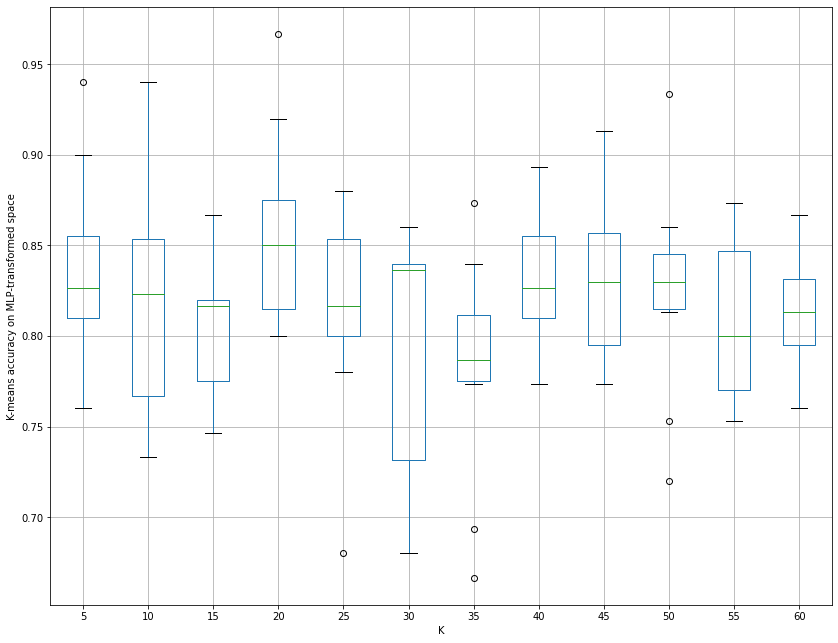

In [41]:
columns = ['5', '10','15', '20', '25', '30', '35', '40', '45', '50', '55', '60']

df = pd.DataFrame(kmeans_acc,
                  columns=columns)
boxplot = df.boxplot(column=columns, figsize=(14,11))  
boxplot.set_ylabel('K-means accuracy on latent space')
boxplot.set_xlabel('K')

Text(0.5, 0, 'K')

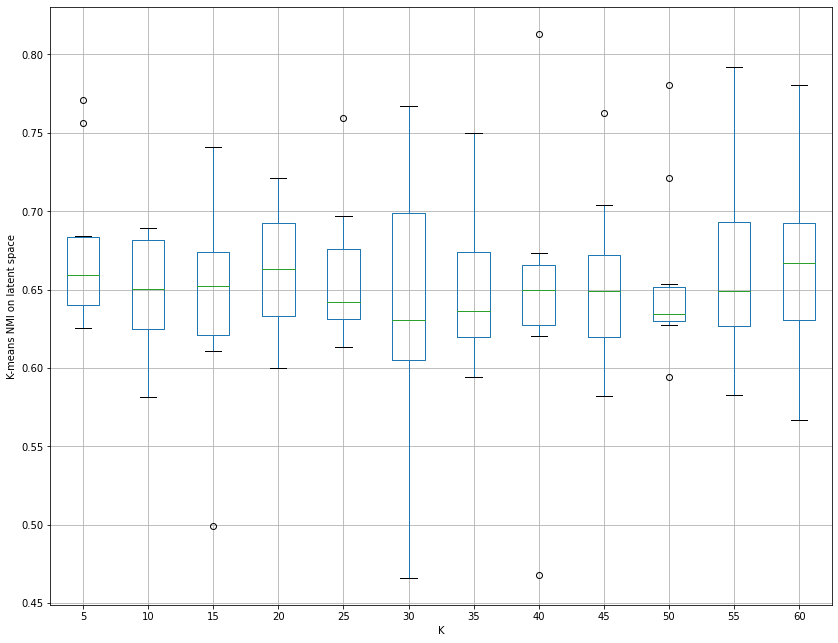

In [42]:
df = pd.DataFrame(kmeans_NMI,
                  columns=columns)
boxplot = df.boxplot(column=columns, figsize=(14,11))  
boxplot.set_ylabel('K-means NMI on latent space')
boxplot.set_xlabel('K')

Text(0.5, 0, 'K')

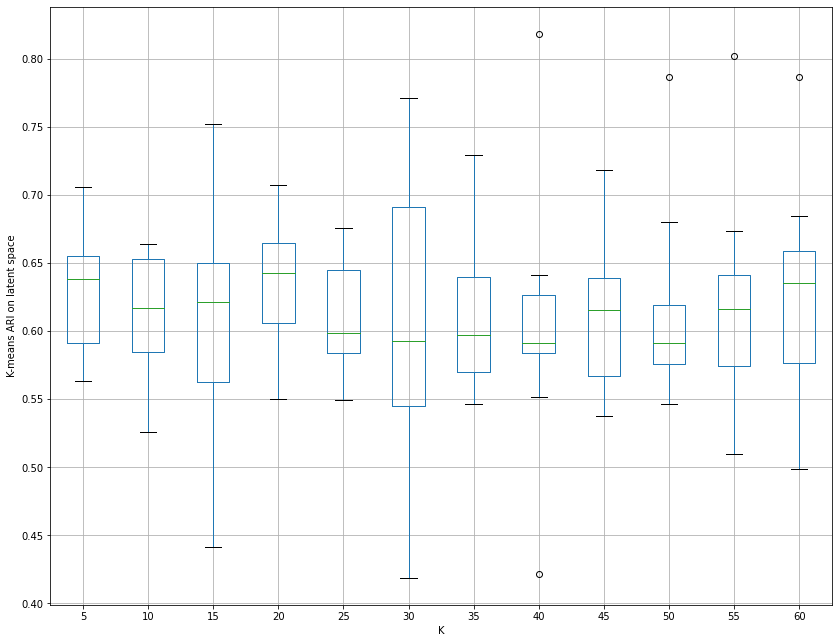

In [43]:
df = pd.DataFrame(kmeans_ARI,
                  columns=columns)
boxplot = df.boxplot(column=columns, figsize=(14,11))  
boxplot.set_ylabel('K-means ARI on latent space')
boxplot.set_xlabel('K')

Text(0.5, 0, 'K')

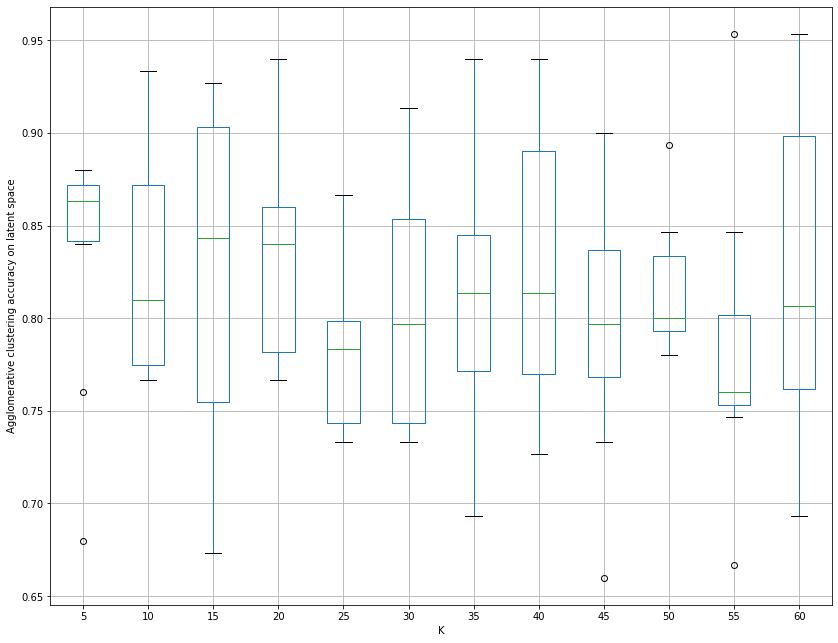

In [44]:
df = pd.DataFrame(agglo_acc,
                  columns=columns)
boxplot = df.boxplot(column=columns, figsize=(14,11))  
boxplot.set_ylabel('Agglomerative clustering accuracy on latent space')
boxplot.set_xlabel('K')

Text(0.5, 0, 'K')

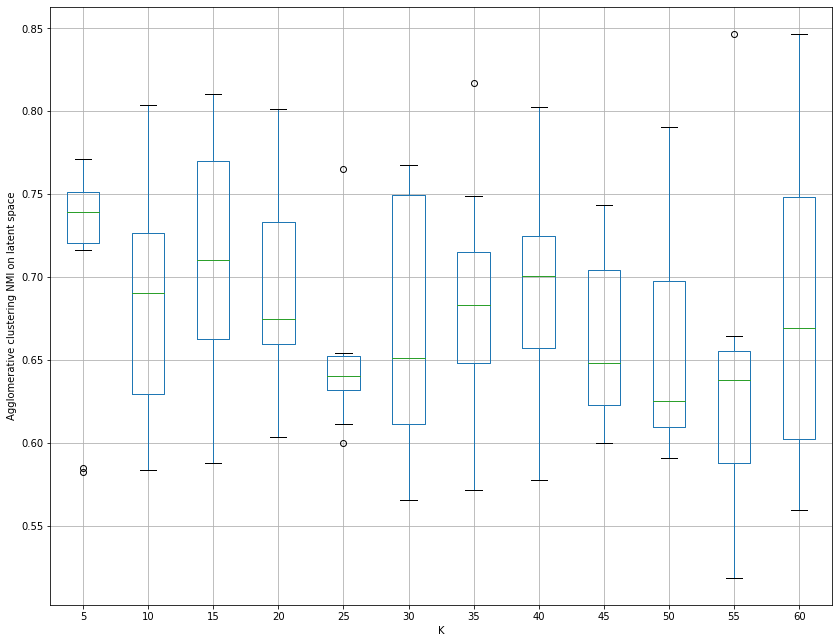

In [47]:
df = pd.DataFrame(agglo_NMI,
                  columns=columns)
boxplot = df.boxplot(column=columns, figsize=(14,11))  
boxplot.set_ylabel('Agglomerative clustering NMI on latent space')
boxplot.set_xlabel('K')

Text(0.5, 0, 'K')

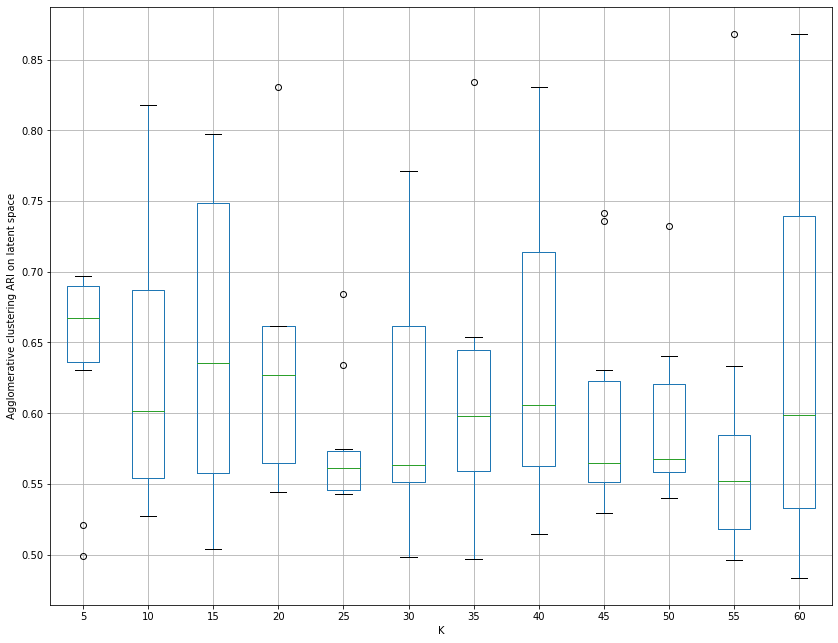

In [46]:
df = pd.DataFrame(agglo_ARI,
                  columns=columns)
boxplot = df.boxplot(column=columns, figsize=(14,11))  
boxplot.set_ylabel('Agglomerative clustering ARI on latent space')
boxplot.set_xlabel('K')